# SBU CSE 352 - HW 4 - Machine Learning From Scratch


All student names in group: Zachary Lowinger, Stanley Yu, James Carl Nanas

I understand that my submission needs to be my own group's work: JZ, SY, JCN

I understand that ChatGPT / Copilot / other AI tools are not allowed: JZ, SY, JCN

---

## Instructions

Total Points: 100

1. Complete this notebook. Use the provided notebook cells and insert additional code and markdown cells as needed. Only use standard packages (numpy and built-in packages like random). Submit the completely rendered notebook as a HTML file.

  **Important:** Do not use scikit-learn or other packages with ML built in. The point of this is to be a learning exercise. Using linear algebra from numpy is okay (things like matrix operations or pseudoinverse, for example, but not lstsq).

2. Your notebook needs to be formatted professionally.
    - Add additional markdown blocks for your description, comments in the code, add tables and use matplotlib to produce charts where appropriate
    - Do not show debugging output or include an excessive amount of output.
    - Check that your PDF file is readable. For example, long lines are cut off in the PDF file. You don't have control over page breaks, so do not worry about these.
3. Document your code. Add a short discussion of how your implementation works and your design choices.

## Introduction

You will implement several machine learning algorithms and evaluate their accuracy. This will be done for a downscaled version of the MNIST digit recognition dataset.

**Like in real life, some of the tasks you will be asked to do may not be possible, at least directly. In these cases, your job is to figure out why it won't work and either propose a fix (best), or provide a clear explanation why it won't work.**

For example, if the problem says to do k-nearest neighbors with a dataset of a billion points, this could require too much time to do each classification so it's infeasible to evaluate its test accuracy. In this case, you could suggest randomly downsample the data to a more manageable size, which will speed things up by may lose some accuracy. In your answer, then, you should describe the problem and how you solved it and the trade-offs.

# Data
First the code below ensures you have access to the training data (a subset of the MNIST images), consisting of 100 handwritten images of each digit.

In [1]:
# First download the repo and change the directory to be the one where the dependencies are.
# You should only need to do this once per session. If you want to reset, do Runtime -> Disconnect and Delete Runtime
# You can always do !pwd to see the current working directory and !ls to list current files.
!git clone https://github.com/stanleybak/CS7320-AI.git
%cd CS7320-AI/ML
!ls

Cloning into 'CS7320-AI'...
remote: Enumerating objects: 2738, done.
remote: Counting objects: 100% (855/855), done.
remote: Compressing objects: 100% (372/372), done.
remote: Total 2738 (delta 522), reused 796 (delta 478), pack-reused 1883
Receiving objects: 100% (2738/2738), 285.30 MiB | 12.26 MiB/s, done.
Resolving deltas: 100% (1690/1690), done.
Updating files: 100% (135/135), done.
/content/CS7320-AI/ML
line_fitting.ipynb	ML_example.ipynb	ML_for_tictactoe_self_play.ipynb  README.md
mini-mnist-1000.pickle	ML_for_tictactoe.ipynb	MNIST.ipynb


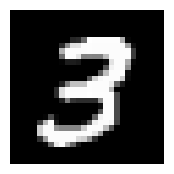

In [2]:
import matplotlib.pyplot as plt
import pickle

# if the below fails to open, then the data file is not in the current working directory (see above code block)
with open('mini-mnist-1000.pickle', 'rb') as f:
  data = pickle.load(f)

im3 = data['images'][300] # 100 images of each digit
plt.figure(figsize=(2, 2))  # Adjust size as needed
plt.imshow(im3, cmap='gray')
plt.axis('off')
plt.show()

# Downscaling Images

MNIST images are originally 28x28. We will train our models not just on the original images, but also on downscaled images with the following sizes: 14x14, 7x7, 4x4, 2x2. The next code block shows one way to do downscaling. As you can tell from the output, we cannot expect our model's accuracy will be too high on lower resolution versions, although it's unclear how much better you can do than random chance, which should have a 10% accuracy.

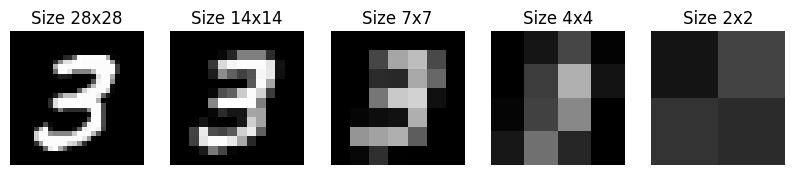

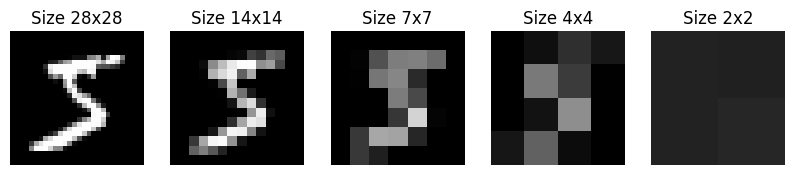

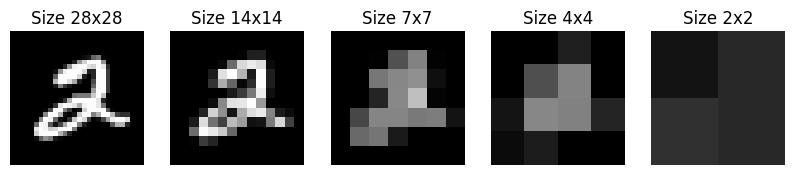

In [3]:
import numpy as np
import pickle
import matplotlib.pyplot as plt

# Function to downscale an image to different sizes
def downscale_image(image, downscaled_size):
    block_size = 28 // downscaled_size
    downscaled = np.zeros((downscaled_size, downscaled_size))
    for i in range(downscaled_size):
        for j in range(downscaled_size):
            # Calculate the average for each block
            block = image[i*block_size:(i+1)*block_size, j*block_size:(j+1)*block_size]
            downscaled[i, j] = np.mean(block)
    return downscaled

# Load the dataset (assuming this file is in your working directory)
with open('mini-mnist-1000.pickle', 'rb') as f:
    data = pickle.load(f)

images = data['images']  # a list of 1000 numpy image matrices
labels = data['labels']  # a list of 1000 integer labels

# Select 3 "random" indices from the dataset
random_indices = [300, 500, 200]

# Downscale the images to multiple sizes and display them
sizes = [28, 14, 7, 4, 2]
for index in random_indices:
    fig, axs = plt.subplots(1, len(sizes), figsize=(10, 2))
    for ax, size in zip(axs, sizes):
        downscaled_image = downscale_image(images[index], size)
        ax.imshow(downscaled_image, cmap='gray', vmin=0, vmax=255)
        ax.set_title(f'Size {size}x{size}')
        ax.axis('off')
    plt.show()

---
# Tasks

Your data contains 100 images in each class. When training models, use 80% of training, 10% for validation and 10% for testing. Make sure the data is balanced in each class when splitting.

---
## Task 1: Linear Classifier [20 points]

First, implement a linear classifier. The simplest way to do this is to adapt linear regression approaches that we learned about in class, where the output is a real number. For classification, we can let one category be an output of 1.0 and the other -1.0. Then, after the classifier is trained we can use the sign of the output to determine the predicted class.

However, since in MNIST there are multiple classes (10 digits, not just 2), we need to adapt the approach further. We will try both of the following two popular strategies: One-vs-Rest (OvR) and One-vs-One (OvO).

**One-vs-Rest (OvR)** is a strategy for using binary classification algorithms for multiclass problems. In this approach, a separate binary classifier is trained for each class, which predicts whether an instance belongs to that class or not, making it the 'one' against all other classes (the 'rest'). For a new input instance, compute the output of all classifiers. The predicted class is the one whose corresponding classifier gives the highest output value.

**One-vs-One (OvO)** is another strategy where a binary classifier is trained for every pair of classes. If there are N classes, you will train N(N−1)/2 classifiers. For a new input, evaluate it using all N(N−1)/2​ classifiers. Count the number of times each class is predicted over all binary classifications. The class with the highest count is selected as the final prediction.

### Report Results
Report the test accuracy for OvR and OvO, for each of the input image sizes, 28x28, 14x14, 7x7, 4x4, 2x2. A table may be helpful. Also report any interesting observations.

In [4]:
# This will be used for all tasks.
sizes = [28, 14, 7, 4, 2]
downscaled_images_by_size = {}  # Each size will have an array of downscaled images as ints.

for image in images:
    for size in sizes:
        if size not in downscaled_images_by_size:
            downscaled_images_by_size[size] = []
        downscaled_image = downscale_image(image, size).astype(int)
        downscaled_images_by_size[size].append(downscaled_image)

# Each downscaled image based on the size is a 2-dimensional array of int values of how dark a pixel is in the 2d array.
downscaled_images_by_size

{28: [array([[  0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
            0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
            0,   0],
         [  0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
            0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
            0,   0],
         [  0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
            0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
            0,   0],
         [  0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
            0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
            0,   0],
         [  0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
            0,   0,  51, 159, 253, 159,  50,   0,   0,   0,   0,   0,   0,
            0,   0],
         [  0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
            0,  48, 238, 252, 252, 252, 237,   0,   0,   0,   0,  

In [32]:
all_data_spilt_by_size = {}

for size in sizes:
    spilt = {}

    # Spilt data into training and testing
    images = downscaled_images_by_size[size]

    total_images = len(images)
    train_size = int(total_images * 0.8)
    dev_size = int(total_images * 0.1)
    test_size = int(total_images * 0.1)

    # Combine data to be shuffled
    images_labels = list(zip(images, labels))

    np.random.seed(42)
    np.random.shuffle(images_labels)

    train_data = images_labels[:train_size]
    dev_data = images_labels[train_size:train_size+dev_size]
    test_data = images_labels[train_size+dev_size:]

    # Spilt data back into images and labels
    X_train = [data[0] for data in train_data]
    y_train = [data[1] for data in train_data]

    X_dev = [data[0] for data in dev_data]
    y_dev = [data[1] for data in dev_data]

    X_test = [data[0] for data in test_data]
    y_test = [data[1] for data in test_data]

    spilt['X_train'] = X_train
    spilt['y_train'] = y_train
    spilt['X_dev'] = X_dev
    spilt['y_dev'] = y_dev
    spilt['X_test'] = X_test
    spilt['y_test'] = y_test

    all_data_spilt_by_size[size] = spilt

all_data_spilt_by_size

{28: {'X_train': [array([[  0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
             0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
             0,   0],
          [  0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
             0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
             0,   0],
          [  0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
             0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
             0,   0],
          [  0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
             0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
             0,   0],
          [  0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
             0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
             0,   0],
          [  0,   0,   0,   0,   0,  13, 255, 255, 163,   7,   7,   7,  95,
           130, 130, 130, 130, 130, 130

In [33]:
import numpy as np

#Given Training data size (something) x, labels size (something) y
def train_model_OvA (data_by_size,size):

  models = [] #each element contains flattened vectors of weights, with models[digit] being model of digit "digit"
  #initiate models:
  for i in range (0,9+1):
    models.append([0] * (size * size))
  #print(models)
  #train data, using <100 as "-1" and >100 as "1"

  train_data_x = data_by_size['X_train']
  train_data_y = data_by_size['y_train']
  for data,label in zip(train_data_x,train_data_y):

      #get each trainin data as numpy matrix, flattened
      data_matrix = np.array(data)
      data_vector_o = data_matrix.flatten()
      data_vector = np.array(data_vector_o)
      for i in range(0,len(models)):
        model = models[i]
        index = i
        true_classify_value = 1 if label == index else -1

        predicted_classify_total = 0

        for data_point,model_point in zip(data_vector,model): #for each model point
          #predict
          val = 1 if data_point>100 else -1
          #print(model_point)
          predicted_classify_total = predicted_classify_total + (model_point * val)
        predicted_classify_value = 1 if predicted_classify_total>0 else -1

        #2 cases: right, wrong

        if(predicted_classify_value != true_classify_value):
          if(predicted_classify_value>true_classify_value):
            #add vector
            models[i] = model - data_vector
          else:
            #subtract vector
            models[i] = model + data_vector
  return models


In [34]:
def test_model_OvA(model_to_test, data_by_size, test_or_validate): #given model vector and data (one size only)
  if test_or_validate == 1: #test
    train_data_x = data_by_size['X_test']
    train_data_y = data_by_size['y_test']
  else: #validate
    train_data_x = data_by_size['X_dev']
    train_data_y = data_by_size['y_dev']
  num_correct = 0
  num_total = 0
  model_data = [] #each element corresponds to each model in model vector
  #initiate model correctness data:
  for i in range (0,9+1):
    model_data.append([[0] * 2]) #correct classification, total classification
  #print(model_data)
  for data,label in zip(train_data_x,train_data_y):#for each data in training

    #get each  data as numpy matrix, flattened
    data_matrix = np.array(data)
    data_vector_o = data_matrix.flatten()
    data_vector = np.array(data_vector_o)
    #see if the model classifies correctly

    model_output = []
    for i in range (0,9+1):
      model_output.append(0) #this shall store the number of counts the model has

    #for model,m_data in zip(model_to_test,model_data): #for each model built
    for i in range(0,len(model_to_test)):
      model = model_to_test[i]
      m_data = model_data[i]
      true_classify_value = 1 if label == i else -1
      #calculate predicted value
      predicted_classify_total = 0
      for data_point,model_point in zip(data_vector,model):
        val = 1 if data_point>100 else -1
        predicted_classify_total += (model_point * val)

      predicted_classify_value = 1 if predicted_classify_total>0 else -1
      model_output[i] = (predicted_classify_total)
      #if correct, add 1 to correctness value else do not add
      #print (m_data)
      if(predicted_classify_value == true_classify_value ) :
        m_data[0][0] = m_data[0][0]+1
      m_data[0][1] = m_data[0][1]+1
    #print(model_output)
    chosen_val = np.argmax(np.abs(model_output))
    #print("C",chosen_val)
    #print("L",label)
    if(chosen_val == label):
      num_correct+=1
    num_total+=1

  for final_data in model_data:
    #print(final_data)
    print("Model accuracy: ", final_data[0][0]/final_data[0][1])
  #print("Model Overall Accuracy: ", num_correct/num_total)
  print()
  return num_correct/num_total



#models = train_model_OvA(all_data_spilt_by_size[28],28)

#test_model_OvA(models,all_data_spilt_by_size[28],1)

#

In [35]:
import pandas as pd
sizes = [28, 14, 7, 4, 2]
model_accuracy = []
for size in sizes:
  models = train_model_OvA(all_data_spilt_by_size[size],size)
  accuracy = test_model_OvA(models,all_data_spilt_by_size[size],1)
  model_accuracy.append(accuracy)

df = pd.DataFrame({
    'Size': sizes,
    'Accuracy': model_accuracy
})

print(df)

Model accuracy:  0.19
Model accuracy:  0.23
Model accuracy:  0.21
Model accuracy:  0.21
Model accuracy:  0.25
Model accuracy:  0.2
Model accuracy:  0.17
Model accuracy:  0.22
Model accuracy:  0.2
Model accuracy:  0.13

Model accuracy:  0.2
Model accuracy:  0.22
Model accuracy:  0.19
Model accuracy:  0.22
Model accuracy:  0.25
Model accuracy:  0.19
Model accuracy:  0.16
Model accuracy:  0.21
Model accuracy:  0.22
Model accuracy:  0.14

Model accuracy:  0.41
Model accuracy:  0.41
Model accuracy:  0.38
Model accuracy:  0.38
Model accuracy:  0.49
Model accuracy:  0.34
Model accuracy:  0.36
Model accuracy:  0.44
Model accuracy:  0.32
Model accuracy:  0.36

Model accuracy:  0.88
Model accuracy:  0.31
Model accuracy:  0.23
Model accuracy:  0.31
Model accuracy:  0.3
Model accuracy:  0.25
Model accuracy:  0.29
Model accuracy:  0.26
Model accuracy:  0.29
Model accuracy:  0.24

Model accuracy:  0.89
Model accuracy:  0.9
Model accuracy:  0.9
Model accuracy:  0.88
Model accuracy:  0.87
Model accura

The accuracy tends to be higher for a higher size, with the size 2 accuracy being only 1% greater than the "random chance" accuracy. The size 4 is not much better, being only 5% greater than the "random chance" accuracy. This is due to the fact that with more data points to go up against, the models will be more accurate. Essentially, with the models going off of very little data points, there is not much to differentiate between different digits with the data, so thus the models will naturally have more trouble diffrentiating between the various digits.

In [37]:

import numpy as np
from itertools import combinations

#Given Training data size (something) x, labels size (something) y
def train_model_OvO (data_by_size,size):
  class_pairs = list(combinations(range(0, 10), 2))
  class_pairs_d = {}
  model_finder = {}
  models = [] #each element contains flattened vectors of weights, with models[digit]

  #Initiate dictionary of models using model_finder
  for index, category in enumerate(class_pairs):
    model_finder[index] = category

   #initiate models:
  for i in range (0,(int)((10 * 9)/2)):
    models.append([0] * (size * size))
  #print(models)

  train_data_x = data_by_size['X_train']
  train_data_y = data_by_size['y_train']

  #for training data:
  for data,label in zip(train_data_x,train_data_y):
      #get each trainin data as numpy matrix, flattened
      data_matrix = np.array(data)
      data_vector_o = data_matrix.flatten()
      data_vector = np.array(data_vector_o)
      expected_value = 0
      #for model in models:
      for i in range(0,len(models)):
        model = models[i]
        model_pos = model_finder[i]
        #category = model_finder[index]
        expected_value = 0 #neither
        if(model_pos[0] == label): #LEFT number
          expected_value = -1
        elif(model_pos[1] == label): #RIGHT number
          expected_value = 1
        predicted_classify_total = 0

        if(expected_value != 0): #if the data involves the model
          for data_point,model_point in zip(data_vector,model): #for each model point
            #predict
            val = 1 if data_point>100 else -1
            #print(model_point)
            predicted_classify_total = predicted_classify_total + (model_point * val)
          #predicted_classify_value = 1 if predicted_classify_total>0 else -1
          predicted_classify_value = 1
          if(predicted_classify_total<0):
            predicted_classify_value = -1
          elif predicted_classify_total>0:
            predicted_classify_value = 1
          #else:
          #  predicted_classify_value = 0

        #2 cases for the model: right, wrong
          if(predicted_classify_value != expected_value):
            if(predicted_classify_value>expected_value):
              #add vector
              models[i] = model - data_vector
            else:
            #subtract vector
              models[i] = model + data_vector

  return models

def test_model_OvO(model_to_test, data_by_size, test_or_validate): #given model vector and data (one size only)
  if test_or_validate == 1: #test
    train_data_x = data_by_size['X_test']
    train_data_y = data_by_size['y_test']
  else: #validate
    train_data_x = data_by_size['X_dev']
    train_data_y = data_by_size['y_dev']

  class_pairs = list(combinations(range(0, 10), 2))
  #print(class_pairs)
  class_pairs_d = {}
  model_finder = {}
  #Initiate dictionary of models using model_finder
  for index, category in enumerate(class_pairs):
    model_finder[index] = category
  num_correct = 0
  num_total = 0
  model_data = [] #each element corresponds to each model in model vector

  for data,label in zip(train_data_x,train_data_y):#for each data

    data_matrix = np.array(data)
    data_vector_o = data_matrix.flatten()
    data_vector = np.array(data_vector_o)

    model_result_count = [0] * 10 #stores the number of counts predicted by the models

    #for model,m_data in zip(model_to_test,model_data): #for each model built
    for i in range(0,len(model_to_test)):
      #run the model
      model = model_to_test[i]
      #m_data = model_data[i]
      model_pos = model_finder[i]
      true_classify_value = 0;
      if(label == model_pos[0]):
        true_classify_value = -1
      elif(label == model_pos[1]):
        true_classify_value = 1
      #true_classify_value = 1 if label == model_pos[0] else -1
      #calculate predicted value

      predicted_classify_total = 0

      for data_point,model_point in zip(data_vector,model):
        val = 1 if data_point>100 else -1
        predicted_classify_total += (model_point * val)
      predicted_classify_value = 1 if predicted_classify_total>0 else -1

      if(predicted_classify_value == 1):
        model_result_count[model_pos[1]] += 1
      else:
        model_result_count[model_pos[0]] += 1
      #print(model_result_count)

    chosen_val = np.argmax(np.abs(model_result_count))
    #print(model_result_count)
    #print("C: ",chosen_val)
    #print("L: ", label)
    #print()
    if(chosen_val == label):
      num_correct += 1
    num_total += 1

  #print("Total Model Accuracy: ", num_correct/num_total)
  return num_correct/num_total

#models = train_model_OvO(all_data_spilt_by_size[28],28)
#print(models)
#test_model_OvO(models,all_data_spilt_by_size[28],1)

In [38]:
import pandas as pd
sizes = [28, 14, 7, 4, 2]
model_accuracy = []
for size in sizes:
  models = train_model_OvO(all_data_spilt_by_size[size],size)
  accuracy = test_model_OvO(models,all_data_spilt_by_size[size],1)
  model_accuracy.append(accuracy)

df = pd.DataFrame({
    'Size': sizes,
    'Accuracy': model_accuracy
})

print(df)

   Size  Accuracy
0    28      0.45
1    14      0.48
2     7      0.49
3     4      0.21
4     2      0.05


Interestingly enough, it appears that the accuracy peaks at around size 7, with a 49% accuracy level followed closely by the 14 size at a 48% accuracy. The accuracy appears to be lower at size 28 which is surprising because it would be expected that with more data points, the accuracy will be greater. This suggests that the models may have trouble differentiating between various digits with more data points. The models are mostly wrong at size 2, which can be explained by the lack of such data points making it difficult for the models to judge on which digit corresponds to which number with each model having to differentiate between each a unique pair of digits.

---
## Task 2: Data Augmentation [20 points]

Your boss was unhappy with the test accuracy, especially of your 2x2 image classifier, and has made some suggestions. The problem, according to your boss, is that there is not enough data in each input $x$. You are told to augment the data with derived features in order to help the classifier.

Specifically, given an input $x$, create additional attributes by computing all of the data up to powers of two. For example, in the 2x2 case your example $x$ consists of four pixel values $x_0$, $x_1$, $x_2$, and $x_3$. Your new input data would have:

* all power of zero: 1 (constant)
* all powers of one: $x_0$, $x_1$, $x_2$, $x_3$
* all powers of two:

  $x_0^2$, $x_0 x_1$, $x_0 x_2$, $x_0 x_3$,
  
  $x_1^2$, $x_1 x_2$, $ x_1 x_3$,
  
  $x_2^2$, $x_2 x_3$,
  
  $x_3^2$

The data would have 15 values, which has the potential to learn nonlinear relationships between the original inputs, which was not possible before.

### Report Results

Report the test accuracy for OvR only, with the data augmentation approach, for each of the input image sizes, 28x28, 14x14, 7x7, 4x4, 2x2 (again, perhaps incorporating a table). Report any interesting results or observations.

Also, explain to your boss what the danger is of looking at a model's final test accuracy and then suggesting changes to improve it. What should be done instead, if you know you will consider different types of models or hyperparameters in the same model class?

Before we do anything here, we have to emphasize the fact that we can't completely augment the data for sizes 28x28 and
event 14x14, since doing that will take a lot of computation time. Instead, here we are just applying all powers of zero,
all powers of one, but for powers of two, we only perform $x_0^2$, $x_1^2$, etc. This will inevitably sacrifice some accuracy
for more manageable computation time.

In [39]:
# Your answer goes here
import numpy as np

def augment_data(downscaled_images_by_size, sizes):
    augmented_downscaled_images_by_size = {}
    for size in sizes:
        if size not in augmented_downscaled_images_by_size:
            augmented_downscaled_images_by_size[size] = []

        # For each flattened image, augment the data points for each image up to powers of 2.
        # I.e. for 2x2 image:
        # [1
        # x_0, x_1, x_2, x_3
        # x_1^2, x_1 x_2, x_1 x_3
        # x_2^2, x_2 x_3
        # x_3^2]
        downscaled_images = downscaled_images_by_size[size]
        for downscaled_image in downscaled_images:
            flattened_downscaled_image = np.array((np.array(downscaled_image)).flatten())
            augmented_downscaled_image = [1, *flattened_downscaled_image]
            image_length = len(flattened_downscaled_image)

            # Skip completely augmenting sizes 28 and 14 since there will be too many data points for each image instance.
            # Instead, for each data point, compute powers of 0, 1, and then only take the power of 2 with the data point by itself
            # The reason for this is because there will be too many points in a single image instance of those sizes, taking too much computation time.
            if size >= 14:
                for i in range(0, image_length):
                    data_point = flattened_downscaled_image[i]
                    augmented_downscaled_image.append(data_point * data_point)
            else:
                # Compute all possible computations of data points to a power of 2.
                for i in range(0, image_length):
                    data_point1 = flattened_downscaled_image[i]
                    for j in range(i, image_length):
                        data_point2 = flattened_downscaled_image[j]
                        augmented_downscaled_image.append(data_point1 * data_point2)

            # Add the new array of augmented data points to the dataset.
            augmented_downscaled_images_by_size[size].append(augmented_downscaled_image)

    return augmented_downscaled_images_by_size

In [40]:
import pandas as pd
sizes = [28, 14, 7, 4, 2]

# Note: The augmented downscaled images will be displayed as flattened vectors.
augmented_downscaled_images_by_size = augment_data(downscaled_images_by_size, sizes)
size_28_df = pd.DataFrame({
    'Images': augmented_downscaled_images_by_size[28],
    'Labels': labels
})
size_14_df = pd.DataFrame({
    'Images': augmented_downscaled_images_by_size[14],
    'Labels': labels
})
size_7_df = pd.DataFrame({
    'Images': augmented_downscaled_images_by_size[7],
    'Labels': labels
})
size_4_df = pd.DataFrame({
    'Images': augmented_downscaled_images_by_size[4],
    'Labels': labels
})
size_2_df = pd.DataFrame({
    'Images': augmented_downscaled_images_by_size[2],
    'Labels': labels
})
print("Size 28x28 augmented images:\n", size_28_df)
print("Size 14x14 augmented images:\n", size_14_df)
print("Size 7x7 augmented images:\n", size_7_df)
print("Size 4x4 augmented images:\n", size_4_df)
print("Size 2x2 augmented images:\n", size_2_df)

Size 28x28 augmented images:
                                                 Images  Labels
0    [1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...       0
1    [1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...       0
2    [1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...       0
3    [1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...       0
4    [1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...       0
..                                                 ...     ...
995  [1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...       9
996  [1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...       9
997  [1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...       9
998  [1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...       9
999  [1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...       9

[1000 rows x 2 columns]
Size 14x14 augmented images:
                                                 Images  Labels
0    [1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...       0
1    [1, 0, 0, 0, 0, 0, 0, 0, 0, 

In [41]:
# Split the data into training data and test data using the same methodology as in task 1.
def split_data(sizes, downscaled_images_by_size, labels):
    all_data_split_by_size = {}
    for size in sizes:
        split = {}

        # Spilt data into training and testing
        images = downscaled_images_by_size[size]

        total_images = len(images)
        train_size = int(total_images * 0.8)
        dev_size = int(total_images * 0.1)
        test_size = int(total_images * 0.1)

        # Combine data to be shuffled
        images_labels = list(zip(images, labels))

        np.random.seed(42)
        np.random.shuffle(images_labels)

        train_data = images_labels[:train_size]
        dev_data = images_labels[train_size:train_size+dev_size]
        test_data = images_labels[train_size+dev_size:]

        # Split data back into images and labels
        X_train = [data[0] for data in train_data]
        y_train = [data[1] for data in train_data]

        X_dev = [data[0] for data in dev_data]
        y_dev = [data[1] for data in dev_data]

        X_test = [data[0] for data in test_data]
        y_test = [data[1] for data in test_data]

        split['X_train'] = X_train
        split['y_train'] = y_train
        split['X_dev'] = X_dev
        split['y_dev'] = y_dev
        split['X_test'] = X_test
        split['y_test'] = y_test

        all_data_split_by_size[size] = split
    return all_data_split_by_size

In [42]:
import pandas as pd
sizes = [28, 14, 7, 4, 2]
augmented_data_split_by_size = split_data(sizes, augmented_downscaled_images_by_size, labels)
augmented_data_split_by_size_28 = augmented_data_split_by_size[28]
df_size_28_split = pd.DataFrame({
    'X_train': augmented_data_split_by_size_28['X_train'],
    'y_train': augmented_data_split_by_size_28['y_train']
})
df_size_28_split

,X_train,y_train
0,"[1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",5
1,"[1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",7
2,"[1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",7
3,"[1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",6
4,"[1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",4
...,...,...
795,"[1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",6
796,"[1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",8
797,"[1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",8
798,"[1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",6


In [43]:
# The functions for training and testing the model with OvA will be slightly different when dealing with augmented
# data that is in the form of a flattened vector.

def augmented_train_model_OvA(data_by_size, size):
    models = [] # Each element contains flattened vectors of weights, with models[digit] being model of digit "digit"

    # Train data, using < 100 as "-1" and > 100 as "1"
    train_data_x = data_by_size['X_train']
    train_data_y = data_by_size['y_train']

    # Initialize the model to work for flattened vectors.
    for i in range (0,9+1):
        models.append(np.array([0] * len(train_data_x[0])))

    # `i` represents the "digit" here
    for i in range(0, len(models)):
        model = models[i]
        for data, label in zip(train_data_x, train_data_y):
          # Get each training data as a list
          data_vector = (np.array(data)).flatten()

          # See if the model classifies correctly
          index = i
          true_classify_value = 1 if label == index else -1

          predicted_classify_total = 0
          for data_point, model_point in zip(data_vector, model): # For each model point
            # Predict
            val = 1 if data_point > 100 else -1
            predicted_classify_total = predicted_classify_total + (model_point * val)
          predicted_classify_value = 1 if predicted_classify_total > 0 else -1

          # 2 cases: right, wrong
          if (predicted_classify_value == true_classify_value):
            pass
          elif (predicted_classify_value != true_classify_value):
            if (predicted_classify_value > true_classify_value):
                # Add vector
                models[i] = model - data_vector
            else:
                # Subtract vector
                models[i] = model + data_vector
    return models

In [44]:
# The functions for training and testing the model with OvA will be slightly different when dealing with augmented
# data that is in the form of a flattened vector.

def augmented_train_model_OvA(data_by_size, size):
    models = [] # Each element contains flattened vectors of weights, with models[digit] being model of digit "digit"

    # Train data, using < 100 as "-1" and > 100 as "1"
    train_data_x = data_by_size['X_train']
    train_data_y = data_by_size['y_train']

    # Initialize the model to work for flattened vectors.
    for i in range (0,9+1):
        models.append(np.array([0] * len(train_data_x[0])))

    for data, label in zip(train_data_x, train_data_y):
        # Get each training data as a list
        data_vector = (np.array(data)).flatten()
        # `i` represents the "digit" here
        for i in range(0, len(models)):
          model = models[i]
          # See if the model classifies correctly
          index = i
          true_classify_value = 1 if label == index else -1

          predicted_classify_total = 0
          for data_point, model_point in zip(data_vector, model): # For each model point
            # Predict
            val = 1 if data_point > 100 else -1
            predicted_classify_total = predicted_classify_total + (model_point * val)
          predicted_classify_value = 1 if predicted_classify_total > 0 else -1

          # 2 cases: right, wrong
          if (predicted_classify_value != true_classify_value):
            if (predicted_classify_value > true_classify_value):
                # Add vector
                models[i] = model - data_vector
            else:
                # Subtract vector
                models[i] = model + data_vector
    return models

In [45]:
import pandas as pd
sizes = [28, 14, 7, 4, 2]
model_accuracy = []
for size in sizes:
  models = augmented_train_model_OvA(augmented_data_split_by_size[size],size)
  accuracy = test_model_OvA(models,augmented_data_split_by_size[size],1)
  model_accuracy.append(accuracy)

df = pd.DataFrame({
    'Size': sizes,
    'Accuracy': model_accuracy
})

print(df)

Model accuracy:  0.53
Model accuracy:  0.58
Model accuracy:  0.5
Model accuracy:  0.46
Model accuracy:  0.6
Model accuracy:  0.45
Model accuracy:  0.48
Model accuracy:  0.55
Model accuracy:  0.45
Model accuracy:  0.42

Model accuracy:  0.81
Model accuracy:  0.87
Model accuracy:  0.84
Model accuracy:  0.81
Model accuracy:  0.86
Model accuracy:  0.72
Model accuracy:  0.8
Model accuracy:  0.81
Model accuracy:  0.66
Model accuracy:  0.79

Model accuracy:  0.84
Model accuracy:  0.91
Model accuracy:  0.94
Model accuracy:  0.8
Model accuracy:  0.85
Model accuracy:  0.82
Model accuracy:  0.83
Model accuracy:  0.84
Model accuracy:  0.73
Model accuracy:  0.79

Model accuracy:  0.9
Model accuracy:  0.92
Model accuracy:  0.86
Model accuracy:  0.88
Model accuracy:  0.84
Model accuracy:  0.9
Model accuracy:  0.85
Model accuracy:  0.91
Model accuracy:  0.83
Model accuracy:  0.82

Model accuracy:  0.85
Model accuracy:  0.89
Model accuracy:  0.87
Model accuracy:  0.72
Model accuracy:  0.86
Model accura

#### Final Results
After augmenting the data and trained the OvA model based on that data, It appears that the overall accuracy decreased instead of increased, as we anticipated. However, for most of the sizes, it appears that each individual model accuracy increased, sometimes by a significant amount. Thus, it appears that the models may have been overfit by the augmentation of such data, which will contribute to the lowering of the overall accuracy.

The danger of looking at a model's final test accuracy and suggesting changes to improve it is the danger of trying to overfit the data based on the model's final test accuracy. Instead, if you know you will consider different types of models or hyperparameters in the same model class, you should incorporate k-fold cross validation to perform k-rounds for one fold testing and k-1 folds for training. There, you can use the average error / accuracy as a better estimate of how the model performs when you have limited data.

---
## Task 3: k-Nearest Neighbors Classifier [20 points]

Your boss is still unhappy with the results (and still ignoring your advice about not using test data accuracy for model decisions).

Next, you are to use the k-nearest neighbors approach to build a classifier for our data. Since we have multiple classes, the one that gets selected can be based on a plurality vote of the $k$ closest samples (whichever category is most frequent). If there are ties, select the class based on the sum of the distances from the test point. For example, if $k=5$, and the closest 5 samples have two pictures that are from category "1" and two pictures that are from category "7", then you choose the output by computing the sum of the distance from the test point and the two "5" samples, as well as the sum of distances from the test point to the two "7" samples, and then outputting the class with the smaller total distance.

### Report Results

For each image size, exhaustively explore different values of $k$ up to 50. Report the best test accuracy. Report the average time taken to do a lookup with the model.

In [ ]:
# Your answer goes here
import numpy as np

#Find distance between vectors x1 and x2, using euclidean distance
def distance(x1, x2):
    return np.linalg.norm(x1 - x2) #This should calculate the euclidean distance between x1 and x2

def most_common_label(k_nearest_labels):
    #Count number of times each label is seen in the k-nearest labels
    label_counter = {}
    for label in k_nearest_labels:
        if label in label_counter:
            label_counter[label] += 1
        else:
            label_counter[label] = 1

    #Get highest in dictionary, this is the most common label
    max_count_seen = 0
    most_common_neighbor = None
    for label, count in label_counter.items():
        if count > max_count_seen:
            max_count_seen = count
            most_common_neighbor = label
    return most_common_neighbor

def k_nearest_neighbors(X_train, y_train, X_test, k):
    predictions = []

    for test_point in X_test: #For a given test point find the closest k points in the training data
        nearest_labels = []
        for train_point, train_label in zip(X_train, y_train):
            distance_away = distance(test_point, train_point)
            nearest_labels.append((distance_away, train_label))

        k_nearest_labels = sorted(nearest_labels, key=lambda x: x[0])[:k] #Sort labels by distance and take the k closest

        #Get the most common label in the k closest labels
        most_common = most_common_label([label for distance, label in k_nearest_labels])
        predictions.append(most_common)
    return predictions


In [ ]:
import time

sizes = [28, 14, 7, 4, 2]
times_to_run = []
for size in sizes:
    #Get data for current size

    train_images = np.array(all_data_spilt_by_size[size]['X_train'])
    train_labels = np.array(all_data_spilt_by_size[size]['y_train'])

    dev_images = np.array(all_data_spilt_by_size[size]['X_dev'])
    dev_labels = np.array(all_data_spilt_by_size[size]['y_dev'])

    test_images = np.array(all_data_spilt_by_size[size]['X_test'])
    test_labels = np.array(all_data_spilt_by_size[size]['y_test'])

    flattened_train_images = [train_image.flatten() for train_image in train_images]
    flattened_dev_images = [dev_image.flatten() for dev_image in dev_images]
    flattened_test_images = [test_image.flatten() for test_image in test_images]

    best_dev_accuracy = (0,0)
    best_test_accuracy = (0,0)
    #Choose k (amount of neighbors ), try 1 to 50
    for k in range(1, 51):
        start = time.time()
        predictions = k_nearest_neighbors(flattened_train_images, train_labels, flattened_dev_images, k)

        #Check the accuracy on the dev set
        correct = 0
        total = len(predictions)

        for pred, label in zip(predictions,dev_labels):
            if pred == label:
                correct +=1

        accuracy= correct/total
        if accuracy > best_dev_accuracy[1]:
            best_dev_accuracy = (k, accuracy)

        end = time.time()
        times_to_run.append(end-start)

        start = time.time()
        #Check the accuracy on the test set
        predictions = k_nearest_neighbors(train_images, train_labels, test_images, k)

        correct = 0
        total = len(predictions)

        for pred, label in zip(predictions,test_labels):
            if pred == label:
                correct +=1

        accuracy= correct/total
        if accuracy > best_test_accuracy[1]:
            best_test_accuracy = (k, accuracy)

        end = time.time()
        times_to_run.append(end-start)

    print(f'For image size {size}x{size}, the best k value for dev set is {best_dev_accuracy[0]} with accuracy {best_dev_accuracy[1]}')
    print(f'For image size {size}x{size}, the best k value for test set is {best_test_accuracy[0]} with accuracy {best_test_accuracy[1]}')
average_time = sum(times_to_run)/len(times_to_run)
print(f'Average time taken to run k-NN is {average_time} seconds')

For image size 28x28, the best k value for dev set is 4 with accuracy 0.86
For image size 28x28, the best k value for test set is 4 with accuracy 0.92
For image size 14x14, the best k value for dev set is 6 with accuracy 0.87
For image size 14x14, the best k value for test set is 6 with accuracy 0.92
For image size 7x7, the best k value for dev set is 5 with accuracy 0.88
For image size 7x7, the best k value for test set is 5 with accuracy 0.88
For image size 4x4, the best k value for dev set is 1 with accuracy 0.79
For image size 4x4, the best k value for test set is 3 with accuracy 0.73
For image size 2x2, the best k value for dev set is 12 with accuracy 0.51
For image size 2x2, the best k value for test set is 11 with accuracy 0.5
Average time taken to run k-NN is 0.3605381684303284 seconds


The algorithm behind this code is we compute the euclidean distance between the given test image and all the training images, we then get the k nearest images to our test image. Then we examine these k images and classify our test image based on which label appears most in our k images.

---
## Task 4: Neural Networks [40 Points]

Next, your boss wants you to try neural networks. Rather than using a library for everything, you will **only** use `pytorch` to perform backpropagation and compute gradients. You can write your own neural network class if desired, don't use anything from `pytorch` for that.


An example network and how to compute gradients with pytorch is shown below.


In [ ]:
# Example of using pytorch to compute gradients and updates weights and biases
#
# The network consists of:
# 1. An input layer with 3 features.
# 2. A first hidden layer with 3 neurons. Each neuron in this layer performs a linear transformation
#    on the input data using a weight matrix (W1) and a bias vector (b1). This is followed by a sigmoid
#    activation function.
# 3. A second hidden layer, also with 3 neurons, which processes the output of the first layer. Similar
#    to the first layer, it uses a weight matrix (W2) and a bias vector (b2) for linear transformation,
#    followed by a softmax activation function. The softmax activation is used here to normalize the
#    output of the second layer into a probability distribution over the three classes. This is particularly
#    useful for multi-class classification problems.
# 4. The network uses cross-entropy as the loss function, which is a common choice for classification tasks
#    involving softmax outputs. This loss function compares the predicted probability distribution with the
#    true distribution (one-hot encoded) and penalizes the predictions that diverge from the actual labels.
#


import torch

# Initialize input, weights, and biases
x = torch.tensor([1.0, 2.0, 3.0])
W1 = torch.tensor([[0.1, 0.2, 0.5],
                  [-0.1, -0.5, -1.1],
                  [0, 7.5, -1.1]], requires_grad=True)
b1 = torch.tensor([0.0, 0.0, 0.0], requires_grad=True)

W2 = torch.tensor([[0.1, -0.3, 0.4],
                  [0.2, 0.4, -0.6],
                  [-0.1, 0.5, -0.2]], requires_grad=True)
b2 = torch.tensor([0.0, 0.0, 0.0], requires_grad=True)

# Target output
y_true = torch.tensor([1.0, 0.0, 0.0])

# Forward pass through first layer
z1 = torch.matmul(W1, x) + b1
a1 = torch.sigmoid(z1)  # Sigmoid activation

# Forward pass through second layer
z2 = torch.matmul(W2, a1) + b2
a2 = torch.softmax(z2, dim=0)  # Softmax activation

print("Initial Output:", a2)
print("Desired Output:", y_true)

# Compute loss (Cross-entropy): https://en.wikipedia.org/wiki/Cross-entropy
loss = -torch.sum(y_true * torch.log(a2))
print("Initial loss:", loss.item())

# Backpropagation
loss.backward()

# you can print out gradient for each element now
print("Gradient for weights matrix W1:", W1.grad)

# Update weights and biases based on gradient (should reduce loss)
learning_rate = 0.02

# the no_grad() environment is needed to indicate that the computation should not
# be part of the gradient computation
with torch.no_grad():
    W1 -= learning_rate * W1.grad
    b1 -= learning_rate * b1.grad
    W2 -= learning_rate * W2.grad
    b2 -= learning_rate * b2.grad

# After the update, clear the gradients (in case we want to compute them again later)
W1.grad.zero_()
b1.grad.zero_()
W2.grad.zero_()
b2.grad.zero_()

# Forward pass with updated weights and biases
z1 = torch.matmul(W1, x) + b1
a1 = torch.sigmoid(z1)  # Sigmoid activation
z2 = torch.matmul(W2, a1) + b2
a2 = torch.softmax(z2, dim=0)  # Softmax activation

# Compute new loss
new_loss = -torch.sum(y_true * torch.log(a2))
print("New loss after updating weights and biases:", new_loss.item())


Initial Output: tensor([0.5348, 0.2167, 0.2485], grad_fn=<SoftmaxBackward0>)
Desired Output: tensor([1., 0., 0.])
Initial loss: 0.625852644443512
Gradient for weights matrix W1: tensor([[-2.9431e-03, -5.8862e-03, -8.8293e-03],
        [ 4.1993e-03,  8.3986e-03,  1.2598e-02],
        [-3.0524e-06, -6.1048e-06, -9.1572e-06]])
New loss after updating weights and biases: 0.6079817414283752


The code above updates the parameters based on a single piece of data, but often multiple inputs are used and their gradient is averaged when updating a model.

Your task is to write the training code for the different neural network architectures proposed and report accuracy. Start with all random parameters between -1 and 1. Training should stop when the accuracy, as measured on the validation data, no longer appears to be improving. You can plot the validation data accuracy over time to ensure this looks correct. If this takes too long but it appears the model is still improving in accuracy, consider increasing the learning rate (start with 0.02 as in the example).

For the gradient, you are to compute the gradient over the full set of training data, and then average them together before you update. Then, repeat with mini-batches of size 100, with 10 random samples from each class. This should update the model weights faster, but may require more updates to get the accuracy down.

### Report Results

Provide at least one plot of your validation data accuracy going down over time as training progresses. What was the condition you decided to use to detect if training should stop? How many updates were needed in the case of your plot?


Create a table where each row corresponds to one model and training method (mini-batch or full). Use the 7x7 version of the data (49-dimensional inputs). You are to explore the following models: the number of hidden layers can be varied between 2 and 4. Each layer's size can be 16, 32, or 64 neurons (all hidden layers have the same number of neurons). Explore three different activation functions for the network, ReLU (`torch.relu`), arctan (`torch.atan`), and sigmoid (`torch.sigmoid`). After the final layer, use a softmax rather than the normal network activation function, to ensure all outputs are between 0 and 1. There should be 10 outputs, one for each class in the MNIST data.

In the table, report the architecture, training time, number of model updates and test accuracy. What is the best architecture? Did mini-batches help with anything? Report any other interesting observations.



In [ ]:
# Write your code here

import torch
import torch.nn as nn

#Define new class for the network, allowed by instructions
#Only using same pytorch functions used in example but using randn and zeros for initialization instead of manual random values

class MNISTNN(torch.nn.Module):
    def __init__(self, activation_function=nn.Sigmoid(), number_of_layers=3, number_of_neurons=64,):
        super(MNISTNN, self).__init__()
        self.weight_1 = torch.randn(number_of_neurons, 7*7, requires_grad=True, dtype=torch.float64)
        self.bias_1 = torch.zeros(number_of_neurons, requires_grad=True, dtype=torch.float64)

        self.weights = nn.ParameterList()
        self.biases = nn.ParameterList()
        for i in range(number_of_layers - 2):
            self.weights.append(nn.Parameter(torch.randn(number_of_neurons, number_of_neurons, dtype=torch.float64)))
            self.biases.append(nn.Parameter(torch.zeros(number_of_neurons, dtype=torch.float64)))

        #Final layer should have 10 neurons one for each class/digit
        self.weight_3 = torch.randn(10, number_of_neurons, requires_grad=True, dtype=torch.float64)
        self.bias_3 = torch.zeros(10, requires_grad=True, dtype=torch.float64)

        self.activation_function = activation_function

    def forward(self, x):
        x = torch.flatten(x, 1)#Flatten images
        x = x.t()
        x = torch.matmul(self.weight_1, x) + self.bias_1.unsqueeze(1)
        x = self.activation_function(x)
        for i in range(len(self.weights)):
            x = torch.matmul(self.weights[i], x) + self.biases[i].unsqueeze(1)
            x = self.activation_function(x)
        x = torch.matmul(self.weight_3, x) + self.bias_3.unsqueeze(1)
        x = torch.softmax(x, dim=0)
        #print(x)
        #print(x.shape)
        return x.t()

model = MNISTNN()

This is our NN where we have x hidden layers given by user with y neurons each given by user and an activation function given by the user. The images is flattened and passed htrough all the layer with the activation function taking place after each layer except for the last layer where we use softmax to get a proababilty distribbution.

In [ ]:
def all_data_training(train_images, train_labels, dev_images, dev_labels, test_images, test_labels, learning_rate=0.03, loss_fn=nn.CrossEntropyLoss(), model=MNISTNN(), batch_size_dev=100):
    start = time.time()
    #Training loop

    train_images = np.array(train_images)
    train_labels = np.array(train_labels)

    epoch = 0
    highest_accuracy_seen = 0
    waiter = 0
    model_updates = 0

    accuracy_list_over_epochs = []

    while True:
        epoch += 1

        #Shuffle data
        train_indices = np.arange(len(train_images))
        np.random.shuffle(train_indices)
        train_images_shuffled = train_images[train_indices]
        train_labels_shuffled = train_labels[train_indices]

        model.train()

        train_images = torch.tensor(train_images_shuffled, dtype=torch.float64)
        train_labels = torch.tensor(train_labels_shuffled, dtype=torch.float64)

        #Forward pass on training data
        outputs = model(train_images)

        loss = loss_fn(outputs, train_labels.long())

        #Back prop
        loss.backward()

        #Update weights and biases
        with torch.no_grad():
            model.weight_1 -= learning_rate * model.weight_1.grad
            model.bias_1 -= learning_rate * model.bias_1.grad
            for i in range(len(model.weights)):
                model.weights[i] -= learning_rate * model.weights[i].grad
                model.biases[i] -= learning_rate * model.biases[i].grad
            model.weight_3 -= learning_rate * model.weight_3.grad
            model.bias_3 -= learning_rate * model.bias_3.grad

        #Clear grads
        model.weight_1.grad.zero_()
        model.bias_1.grad.zero_()
        for i in range(len(model.weights)):
            model.weights[i].grad.zero_()
            model.biases[i].grad.zero_()
        model.weight_3.grad.zero_()
        model.bias_3.grad.zero_()

        model_updates += 1

        #Print loss
        if epoch %100 == 0:
            print(f'Epoch {epoch+1} Full Data Training Loss: {loss.item()}')

        #Use dev set to check accuracy, if accuracy starts to decrease stop training
        #Use same training loop as above but with dev set, with batches and no back prop
        model.eval()
        with torch.no_grad():
            correct = 0.0
            total = 0.0
            for i in range(0, len(dev_images), batch_size_dev):
                #Use batch
                batch_images = dev_images[i:i+batch_size_dev]
                batch_labels = dev_labels[i:i+batch_size_dev]

                batch_images = torch.tensor(batch_images, dtype=torch.float64)
                batch_labels = torch.tensor(batch_labels, dtype=torch.long)

                #Forward pass
                outputs = model(batch_images)

                #Get labels
                _, predicted_labels = torch.max(outputs.data, 1)

                #Get total correct and total
                total += batch_labels.size(0)
                for pred, label in zip(predicted_labels, batch_labels):
                    if pred == label:
                        correct += 1

            #Calculate accuracy and store it for each epoch used to display graph
            accuracy = correct / total
            accuracy_list_over_epochs.append(accuracy)
            if accuracy <= highest_accuracy_seen:
                if waiter >= 10000: #Will wait for 10000 epochs before stopping if no improvement is made
                    break
                else:
                    waiter += 1
                    #print(f'Waiter: {waiter}')
            else:
                #Reset waiter
                waiter = 0

            #Store highest accuracy and best model for later use
            if(highest_accuracy_seen < accuracy):
                highest_accuracy_seen = accuracy
                best_model = model
            if epoch %100 == 0:
                print(f'Epoch {epoch+1}, Validation Accuracy: {accuracy:0.6f}')
    end = time.time()
    time_taken = end-start
    return accuracy_list_over_epochs, best_model, time_taken, model_updates


In [ ]:
def mini_batch_training(train_images, train_labels, dev_images, dev_labels, test_images, test_labels, batch_size=100, batch_size_dev=100, learning_rate=0.03, loss_fn=nn.CrossEntropyLoss(), model=MNISTNN()):
    start = time.time()
    #Training loop

    train_images = np.array(train_images)
    train_labels = np.array(train_labels)

    epoch = 0
    highest_accuracy_seen = 0
    waiter = 0
    model_updates = 0

    accuracy_list_over_epochs = []

    while True:
        epoch += 1

        #Shuffle data
        train_indices = np.arange(len(train_images))
        np.random.shuffle(train_indices)
        train_images_shuffled = train_images[train_indices]
        train_labels_shuffled = train_labels[train_indices]

        model.train()

        for i in range(0, len(train_images_shuffled), batch_size):
            #Get mini-batch of data
            batch_images = train_images_shuffled[i:i+batch_size]
            batch_labels = train_labels_shuffled[i:i+batch_size]

            batch_images = torch.tensor(batch_images, dtype=torch.float64)
            batch_labels = torch.tensor(batch_labels, dtype=torch.long)

            #Forward pass on training data
            outputs = model(batch_images)

            loss = loss_fn(outputs, batch_labels)

            #Back prop
            loss.backward()

            #Update weights and biases
            with torch.no_grad():
                model.weight_1 -= learning_rate * model.weight_1.grad
                model.bias_1 -= learning_rate * model.bias_1.grad
                for i in range(len(model.weights)):
                    model.weights[i] -= learning_rate * model.weights[i].grad
                    model.biases[i] -= learning_rate * model.biases[i].grad
                model.weight_3 -= learning_rate * model.weight_3.grad
                model.bias_3 -= learning_rate * model.bias_3.grad

            #Clear grads
            model.weight_1.grad.zero_()
            model.bias_1.grad.zero_()
            for i in range(len(model.weights)):
                model.weights[i].grad.zero_()
                model.biases[i].grad.zero_()
            model.weight_3.grad.zero_()
            model.bias_3.grad.zero_()

            model_updates += 1

        #Print loss
        if epoch %100 == 0:
            print(f'Epoch {epoch+1}, Full Data Training Loss: {loss.item()}')

        #Use dev set to check accuracy, if accuracy starts to decrease stop training
        #Use same training loop as above but with dev set, with batches and no back prop
        model.eval()
        with torch.no_grad():
            correct = 0.0
            total = 0.0
            for i in range(0, len(dev_images), batch_size_dev):
                #Use batch
                batch_images = dev_images[i:i+batch_size_dev]
                batch_labels = dev_labels[i:i+batch_size_dev]

                batch_images = torch.tensor(batch_images, dtype=torch.float64)
                batch_labels = torch.tensor(batch_labels, dtype=torch.long)

                #Forward pass
                outputs = model(batch_images)

                #Get labels
                _, predicted_labels = torch.max(outputs.data, 1)

                #Get total correct and total
                total += batch_labels.size(0)
                for pred, label in zip(predicted_labels, batch_labels):
                    if pred == label:
                        correct += 1

            #Calculate accuracy and store it for each epoch used to display graph
            accuracy = correct / total
            accuracy_list_over_epochs.append(accuracy)
            if accuracy <= highest_accuracy_seen:
                if waiter >= 10000: #Will wait for 10000 epochs before stopping if no improvement is made
                    break
                else:
                    waiter += 1
                    #print(f'Waiter: {waiter}')
            else:
                #Reset waiter
                waiter = 0
            #Store highest accuracy and best model for later use
            if(highest_accuracy_seen < accuracy):
                highest_accuracy_seen = accuracy
                best_model = model
            if epoch %100 == 0:
                print(f'Epoch {epoch+1}, Validation Accuracy: {accuracy:0.6f}')
    end = time.time()
    time_taken = end-start
    return accuracy_list_over_epochs, best_model, time_taken, model_updates

In [ ]:
def evaluate_test(model, test_images, test_labels, batch_size_test=100):
    model.eval()
    with torch.no_grad():
        correct = 0.0
        total = 0.0
        for i in range(0, len(test_images), batch_size_test):
            #Use batch
            batch_images = test_images[i:i+batch_size_test]
            batch_labels = test_labels[i:i+batch_size_test]

            batch_images = torch.tensor(batch_images, dtype=torch.float64)
            batch_labels = torch.tensor(batch_labels, dtype=torch.long)

            #Forward pass
            outputs = model(batch_images)

            # Get labels
            _, predicted_labels = torch.max(outputs.data, 1)

            #Get total correct and total
            total += batch_labels.size(0)
            for pred, label in zip(predicted_labels, batch_labels):
                if pred == label:
                    correct += 1

        #Calculate accuracy
        accuracy = correct / total
        print(f'Test Accuracy: {accuracy:0.6f}')
        return accuracy

Our training loops are basically passing our image data into our NN through our forward pass, we then get our loss from our loss function and use this loss for back propagation which updates our weights and bias respectively. We then test our model on our dev set to see if our accuracy has increased. If we have not see an increase in accuracy within 10000 epochs we end our models training to not overfit our model to the training set. With the mini-batches we train our model with smaller subsets of our data instead of training with all of our data at once since in some cases you may be unable to do that due to memory constraints. I used resources from my CSE 354 course and a previous pytorch course I took to help me contruct these training loops.

In [ ]:
train_images = all_data_spilt_by_size[7]['X_train']
train_labels = all_data_spilt_by_size[7]['y_train']

dev_images = all_data_spilt_by_size[7]['X_dev']
dev_labels = all_data_spilt_by_size[7]['y_dev']

test_images = all_data_spilt_by_size[7]['X_test']
test_labels = all_data_spilt_by_size[7]['y_test']

activation_list = [torch.sigmoid, torch.relu, torch.atan]
number_of_layers_list = [2, 3, 4]
number_of_neurons_list = [16, 32, 64]

model_list = []

for activation in activation_list:
    for number_of_layers in number_of_layers_list:
        for number_of_neurons in number_of_neurons_list:
            print(f'Activation: {activation}, Number of Layers: {number_of_layers}, Number of Neurons: {number_of_neurons}')
            model_type = 'full_data_training'
            accuracy_list_over_epochs, model, time_taken, number_of_model_updates = all_data_training(train_images, train_labels, dev_images, dev_labels, test_images, test_labels, learning_rate=0.03, loss_fn=nn.CrossEntropyLoss(), model=MNISTNN(activation_function=activation, number_of_layers=number_of_layers, number_of_neurons=number_of_neurons))
            model_list.append((model_type, model, accuracy_list_over_epochs, time_taken, number_of_model_updates, activation, number_of_layers, number_of_neurons))

Activation: <built-in method sigmoid of type object at 0x00007FF9DFF7BD50>, Number of Layers: 2, Number of Neurons: 16


C:\Users\zacma\AppData\Local\Temp\ipykernel_79032\1006394007.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  train_images = torch.tensor(train_images_shuffled, dtype=torch.float64)
C:\Users\zacma\AppData\Local\Temp\ipykernel_79032\1006394007.py:27: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  train_labels = torch.tensor(train_labels_shuffled, dtype=torch.float64)


Epoch 101 Full Data Training Loss: 2.3289075750371326
Epoch 101, Validation Accuracy: 0.060000
Epoch 201 Full Data Training Loss: 2.327139748658062
Epoch 201, Validation Accuracy: 0.060000
Epoch 301 Full Data Training Loss: 2.32572852986166
Epoch 301, Validation Accuracy: 0.060000
Epoch 401 Full Data Training Loss: 2.3241626188055626
Epoch 401, Validation Accuracy: 0.070000
Epoch 501 Full Data Training Loss: 2.322571280822635
Epoch 501, Validation Accuracy: 0.070000
Epoch 601 Full Data Training Loss: 2.3212834495372956
Epoch 601, Validation Accuracy: 0.070000
Epoch 701 Full Data Training Loss: 2.3200751309646783
Epoch 701, Validation Accuracy: 0.070000
Epoch 801 Full Data Training Loss: 2.318865852319448
Epoch 801, Validation Accuracy: 0.070000
Epoch 901 Full Data Training Loss: 2.3170447812302015
Epoch 901, Validation Accuracy: 0.070000
Epoch 1001 Full Data Training Loss: 2.315616674109362
Epoch 1001, Validation Accuracy: 0.070000
Epoch 1101 Full Data Training Loss: 2.314256024905898


In [ ]:
for activation in activation_list:
    for number_of_layers in number_of_layers_list:
        for number_of_neurons in number_of_neurons_list:
            print(f'Activation: {activation}, Number of Layers: {number_of_layers}, Number of Neurons: {number_of_neurons}')
            model_type = 'mini_batch_training'
            accuracy_list_over_epochs, model, time_taken, number_of_model_updates = mini_batch_training(train_images, train_labels, dev_images, dev_labels, test_images, test_labels, learning_rate=0.03, loss_fn=nn.CrossEntropyLoss(), model=MNISTNN(activation_function=activation, number_of_layers=number_of_layers, number_of_neurons=number_of_neurons))
            model_list.append((model_type, model, accuracy_list_over_epochs, time_taken, number_of_model_updates, activation, number_of_layers, number_of_neurons))

Activation: <built-in method sigmoid of type object at 0x00007FF9DFF7BD50>, Number of Layers: 2, Number of Neurons: 16
Epoch 101, Full Data Training Loss: 2.303736452808832
Epoch 101, Validation Accuracy: 0.110000
Epoch 201, Full Data Training Loss: 2.2869848208094643
Epoch 201, Validation Accuracy: 0.100000
Epoch 301, Full Data Training Loss: 2.2512868010398397
Epoch 301, Validation Accuracy: 0.140000
Epoch 401, Full Data Training Loss: 2.2570382120490704
Epoch 401, Validation Accuracy: 0.190000
Epoch 501, Full Data Training Loss: 2.1993513427095266
Epoch 501, Validation Accuracy: 0.200000
Epoch 601, Full Data Training Loss: 2.16541932013604
Epoch 601, Validation Accuracy: 0.220000
Epoch 701, Full Data Training Loss: 2.1873245668836643
Epoch 701, Validation Accuracy: 0.210000
Epoch 801, Full Data Training Loss: 2.1722852176581453
Epoch 801, Validation Accuracy: 0.200000
Epoch 901, Full Data Training Loss: 2.1964425816616715
Epoch 901, Validation Accuracy: 0.210000
Epoch 1001, Full Dat

Model Type: full_data_training
Activation: <built-in method sigmoid of type object at 0x00007FF9DFF7BD50>, Number of Layers: 2, Number of Neurons: 16
Time taken to train: 209.20499897003174 seconds
Number of model updates: 47807
Test Accuracy: 0.420000


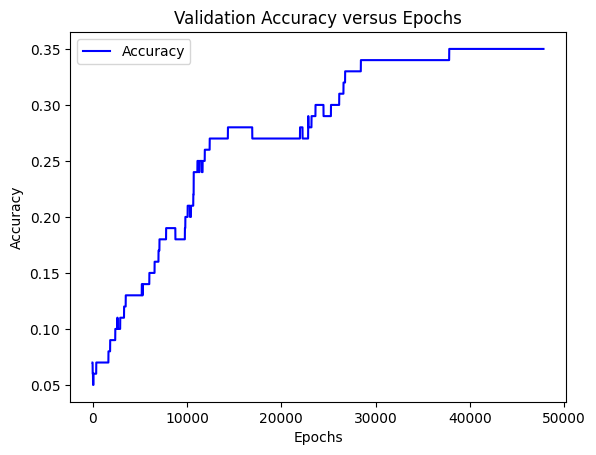

Model Type: full_data_training
Activation: <built-in method sigmoid of type object at 0x00007FF9DFF7BD50>, Number of Layers: 2, Number of Neurons: 32
Time taken to train: 140.18302655220032 seconds
Number of model updates: 29461
Test Accuracy: 0.430000


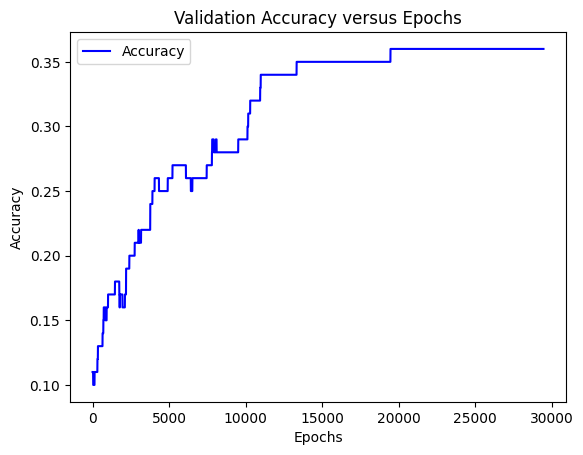

Model Type: full_data_training
Activation: <built-in method sigmoid of type object at 0x00007FF9DFF7BD50>, Number of Layers: 2, Number of Neurons: 64
Time taken to train: 120.84700202941895 seconds
Number of model updates: 24183
Test Accuracy: 0.310000


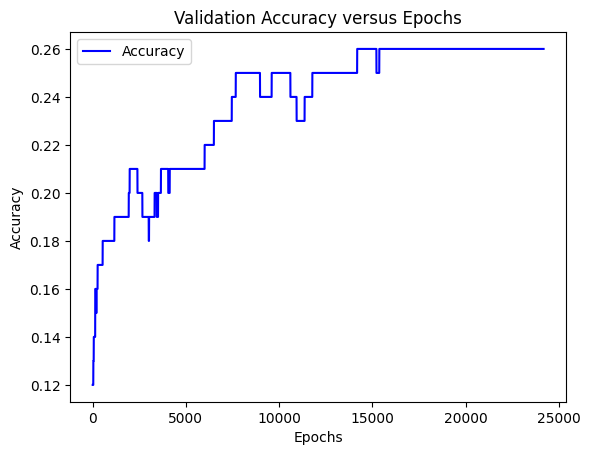

Model Type: full_data_training
Activation: <built-in method sigmoid of type object at 0x00007FF9DFF7BD50>, Number of Layers: 3, Number of Neurons: 16
Time taken to train: 224.87693738937378 seconds
Number of model updates: 47220
Test Accuracy: 0.370000


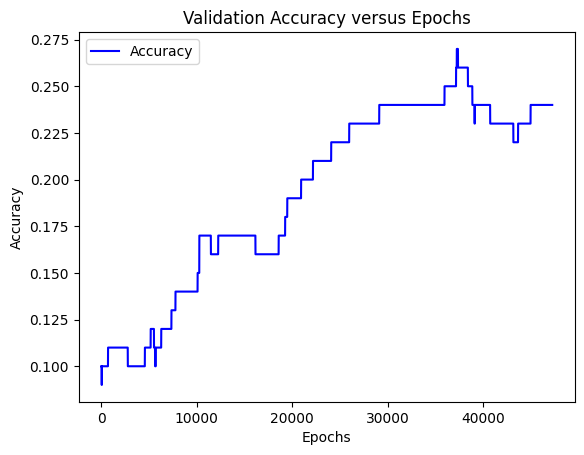

Model Type: full_data_training
Activation: <built-in method sigmoid of type object at 0x00007FF9DFF7BD50>, Number of Layers: 3, Number of Neurons: 32
Time taken to train: 179.92202830314636 seconds
Number of model updates: 32166
Test Accuracy: 0.470000


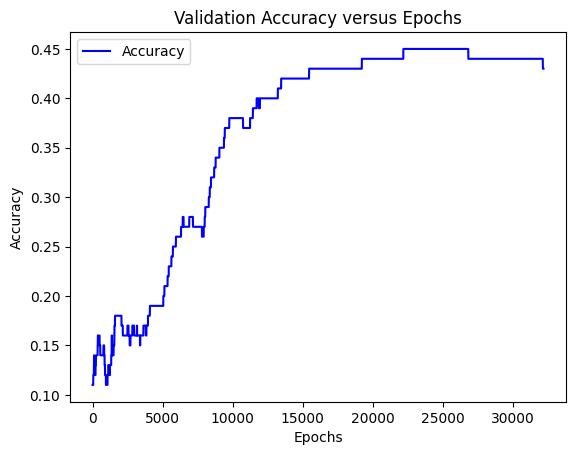

Model Type: full_data_training
Activation: <built-in method sigmoid of type object at 0x00007FF9DFF7BD50>, Number of Layers: 3, Number of Neurons: 64
Time taken to train: 123.25199961662292 seconds
Number of model updates: 19924
Test Accuracy: 0.390000


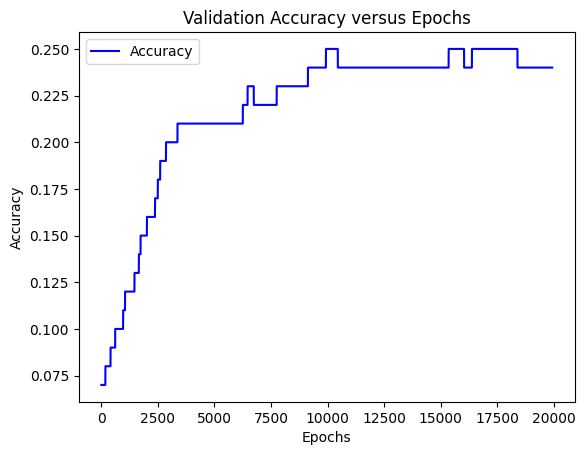

Model Type: full_data_training
Activation: <built-in method sigmoid of type object at 0x00007FF9DFF7BD50>, Number of Layers: 4, Number of Neurons: 16
Time taken to train: 284.546014547348 seconds
Number of model updates: 53599
Test Accuracy: 0.390000


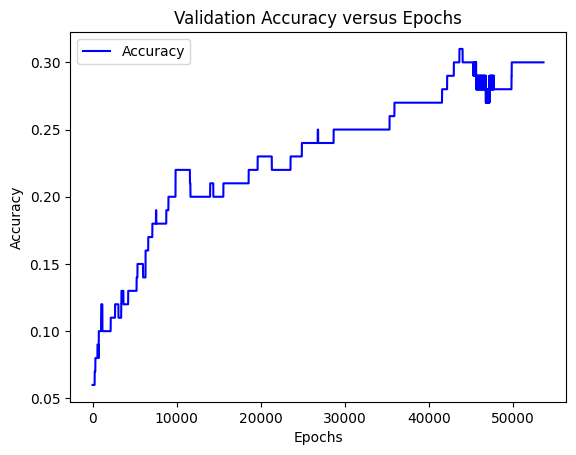

Model Type: full_data_training
Activation: <built-in method sigmoid of type object at 0x00007FF9DFF7BD50>, Number of Layers: 4, Number of Neurons: 32
Time taken to train: 142.06954717636108 seconds
Number of model updates: 22007
Test Accuracy: 0.500000


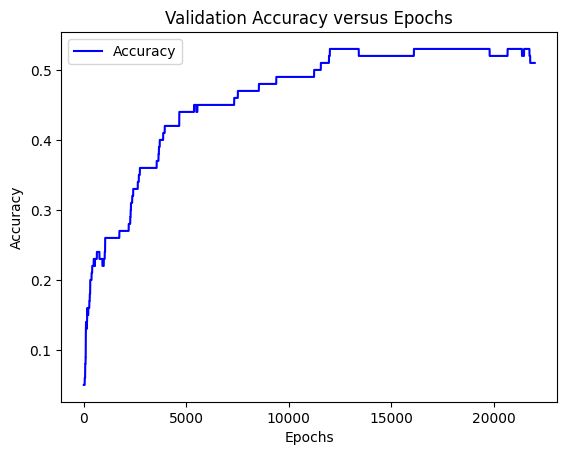

Model Type: full_data_training
Activation: <built-in method sigmoid of type object at 0x00007FF9DFF7BD50>, Number of Layers: 4, Number of Neurons: 64
Time taken to train: 118.26600122451782 seconds
Number of model updates: 16243
Test Accuracy: 0.380000


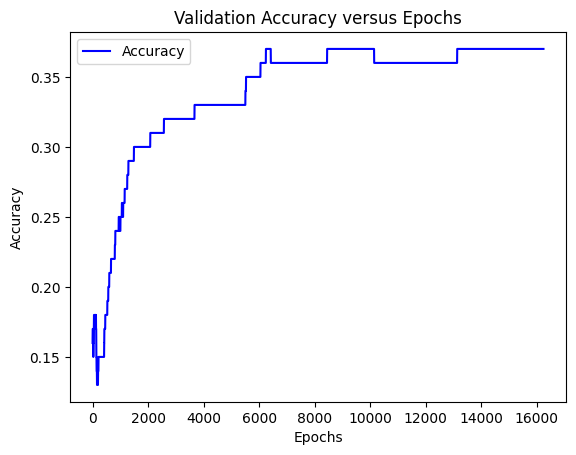

Model Type: full_data_training
Activation: <built-in method relu of type object at 0x00007FF9DFF7BD50>, Number of Layers: 2, Number of Neurons: 16
Time taken to train: 57.971999406814575 seconds
Number of model updates: 13009
Test Accuracy: 0.110000


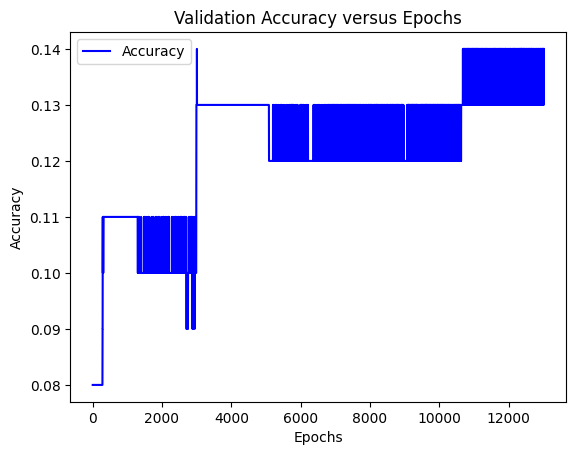

Model Type: full_data_training
Activation: <built-in method relu of type object at 0x00007FF9DFF7BD50>, Number of Layers: 2, Number of Neurons: 32
Time taken to train: 46.775999546051025 seconds
Number of model updates: 10002
Test Accuracy: 0.060000


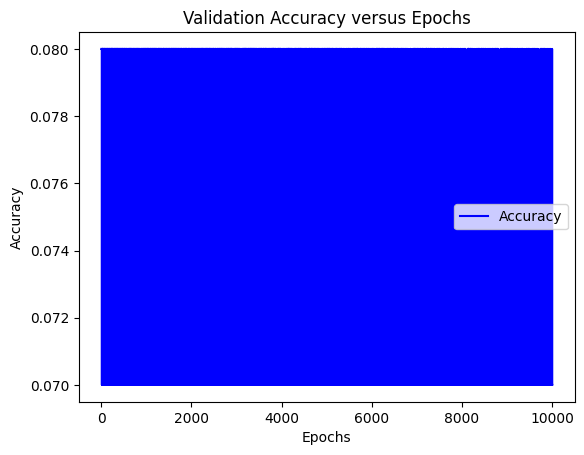

Model Type: full_data_training
Activation: <built-in method relu of type object at 0x00007FF9DFF7BD50>, Number of Layers: 2, Number of Neurons: 64
Time taken to train: 49.14199948310852 seconds
Number of model updates: 10002
Test Accuracy: 0.130000


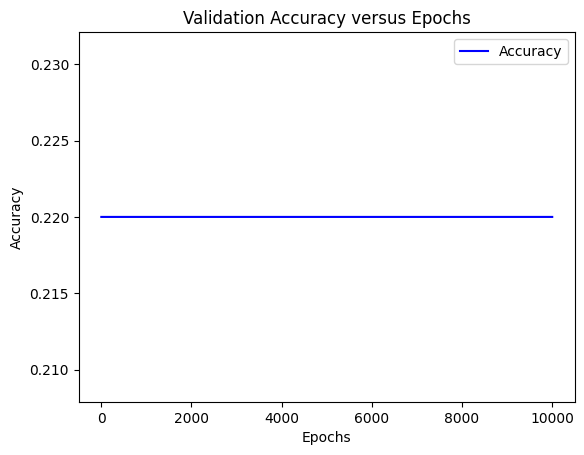

Model Type: full_data_training
Activation: <built-in method relu of type object at 0x00007FF9DFF7BD50>, Number of Layers: 3, Number of Neurons: 16
Time taken to train: 49.00900149345398 seconds
Number of model updates: 10002
Test Accuracy: 0.060000


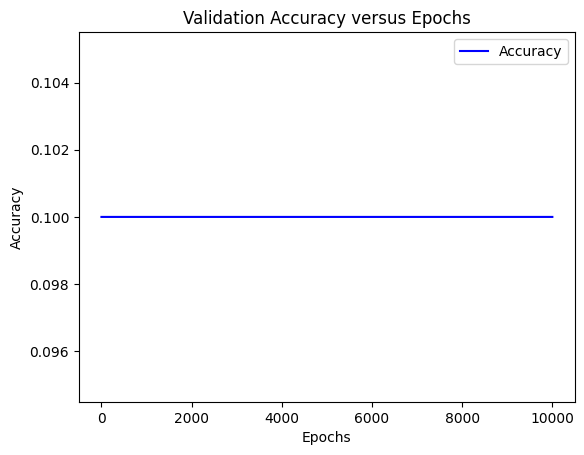

Model Type: full_data_training
Activation: <built-in method relu of type object at 0x00007FF9DFF7BD50>, Number of Layers: 3, Number of Neurons: 32
Time taken to train: 52.328999280929565 seconds
Number of model updates: 10002
Test Accuracy: 0.130000


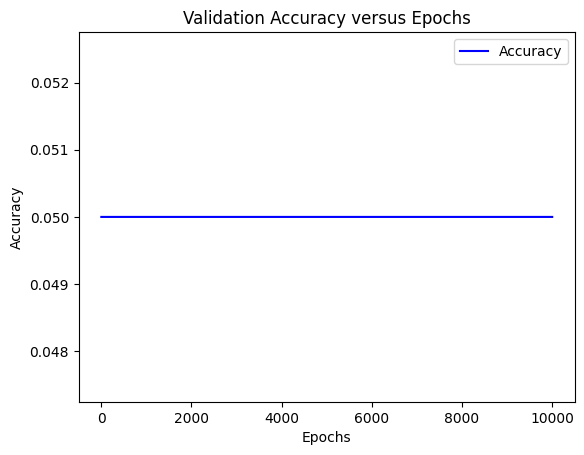

Model Type: full_data_training
Activation: <built-in method relu of type object at 0x00007FF9DFF7BD50>, Number of Layers: 3, Number of Neurons: 64
Time taken to train: 55.489999294281006 seconds
Number of model updates: 10002
Test Accuracy: 0.200000


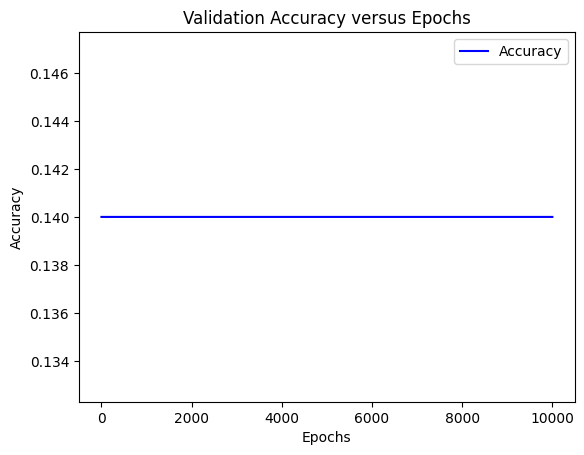

Model Type: full_data_training
Activation: <built-in method relu of type object at 0x00007FF9DFF7BD50>, Number of Layers: 4, Number of Neurons: 16
Time taken to train: 52.97999835014343 seconds
Number of model updates: 10002
Test Accuracy: 0.140000


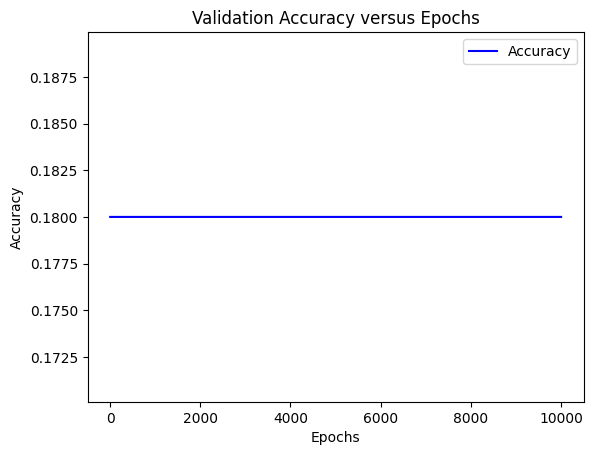

Model Type: full_data_training
Activation: <built-in method relu of type object at 0x00007FF9DFF7BD50>, Number of Layers: 4, Number of Neurons: 32
Time taken to train: 58.20099973678589 seconds
Number of model updates: 10002
Test Accuracy: 0.110000


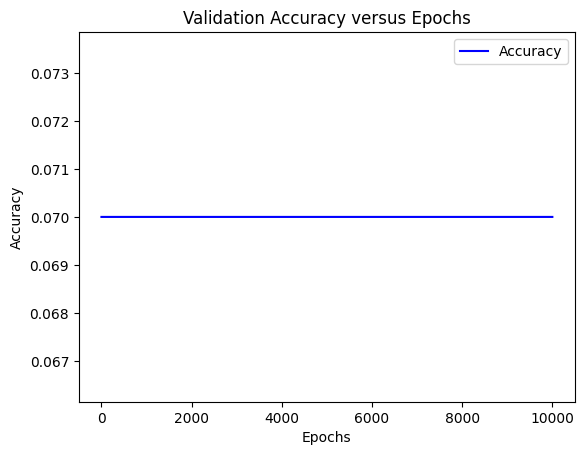

Model Type: full_data_training
Activation: <built-in method relu of type object at 0x00007FF9DFF7BD50>, Number of Layers: 4, Number of Neurons: 64
Time taken to train: 62.62600088119507 seconds
Number of model updates: 10002
Test Accuracy: 0.160000


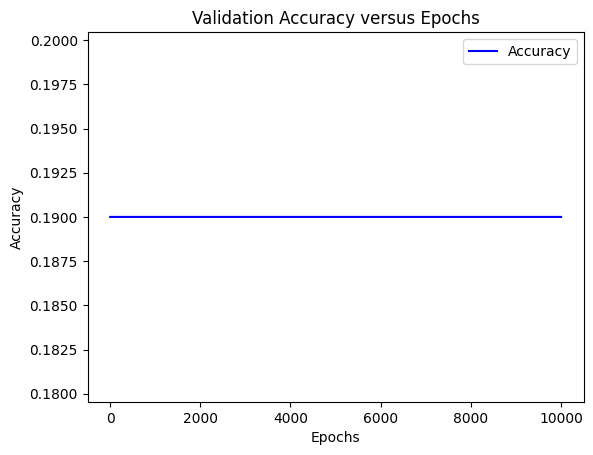

Model Type: full_data_training
Activation: <built-in method atan of type object at 0x00007FF9DFF7BD50>, Number of Layers: 2, Number of Neurons: 16
Time taken to train: 75.73200058937073 seconds
Number of model updates: 18385
Test Accuracy: 0.280000


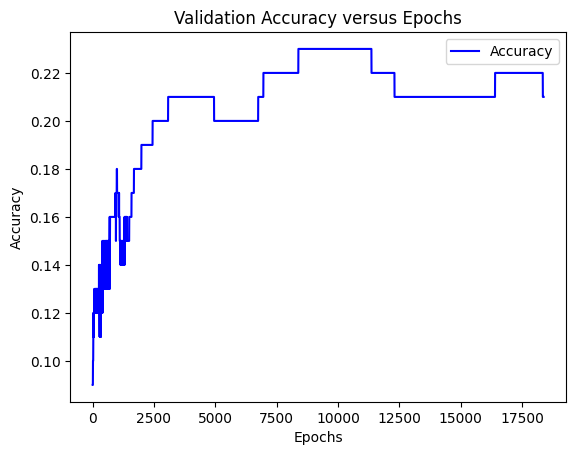

Model Type: full_data_training
Activation: <built-in method atan of type object at 0x00007FF9DFF7BD50>, Number of Layers: 2, Number of Neurons: 32
Time taken to train: 141.31003284454346 seconds
Number of model updates: 32946
Test Accuracy: 0.580000


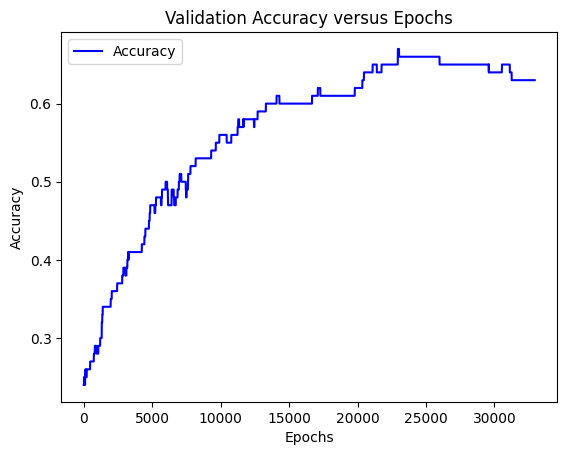

Model Type: full_data_training
Activation: <built-in method atan of type object at 0x00007FF9DFF7BD50>, Number of Layers: 2, Number of Neurons: 64
Time taken to train: 108.87307119369507 seconds
Number of model updates: 24338
Test Accuracy: 0.350000


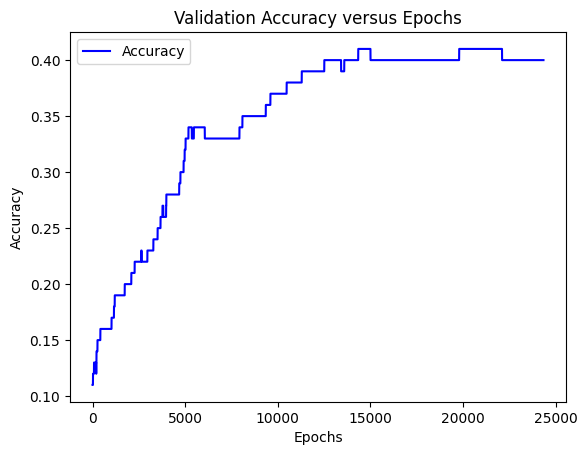

Model Type: full_data_training
Activation: <built-in method atan of type object at 0x00007FF9DFF7BD50>, Number of Layers: 3, Number of Neurons: 16
Time taken to train: 61.31596565246582 seconds
Number of model updates: 13272
Test Accuracy: 0.430000


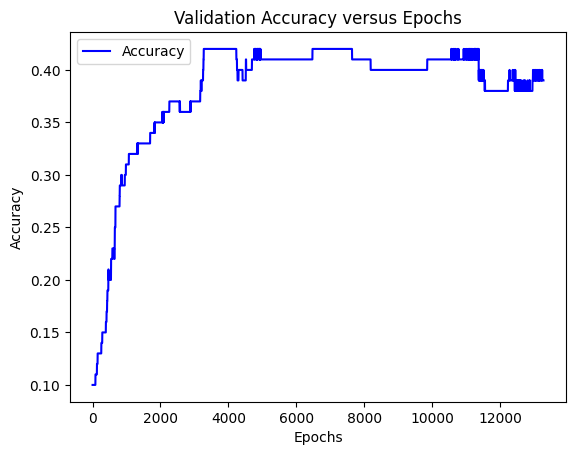

Model Type: full_data_training
Activation: <built-in method atan of type object at 0x00007FF9DFF7BD50>, Number of Layers: 3, Number of Neurons: 32
Time taken to train: 164.92104363441467 seconds
Number of model updates: 34105
Test Accuracy: 0.460000


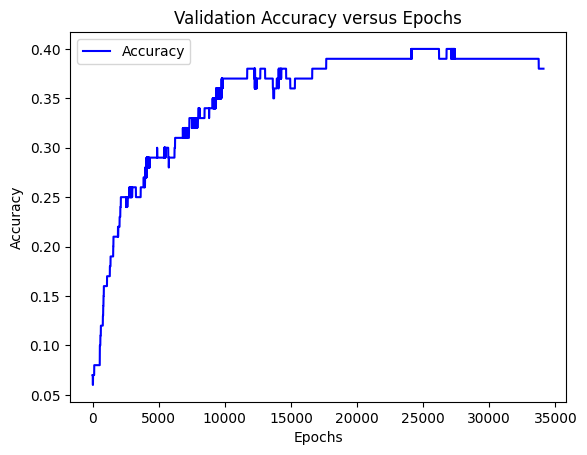

Model Type: full_data_training
Activation: <built-in method atan of type object at 0x00007FF9DFF7BD50>, Number of Layers: 3, Number of Neurons: 64
Time taken to train: 255.14799880981445 seconds
Number of model updates: 48559
Test Accuracy: 0.400000


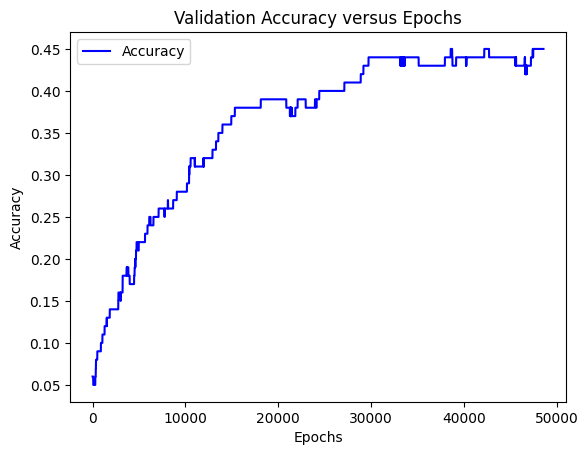

Model Type: full_data_training
Activation: <built-in method atan of type object at 0x00007FF9DFF7BD50>, Number of Layers: 4, Number of Neurons: 16
Time taken to train: 155.69703030586243 seconds
Number of model updates: 32249
Test Accuracy: 0.280000


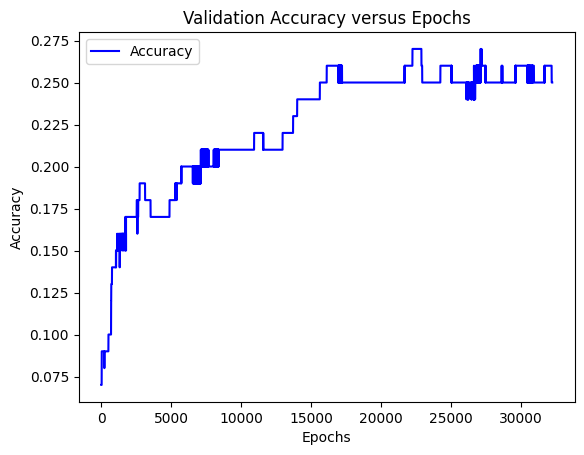

Model Type: full_data_training
Activation: <built-in method atan of type object at 0x00007FF9DFF7BD50>, Number of Layers: 4, Number of Neurons: 32
Time taken to train: 117.38800001144409 seconds
Number of model updates: 22277
Test Accuracy: 0.390000


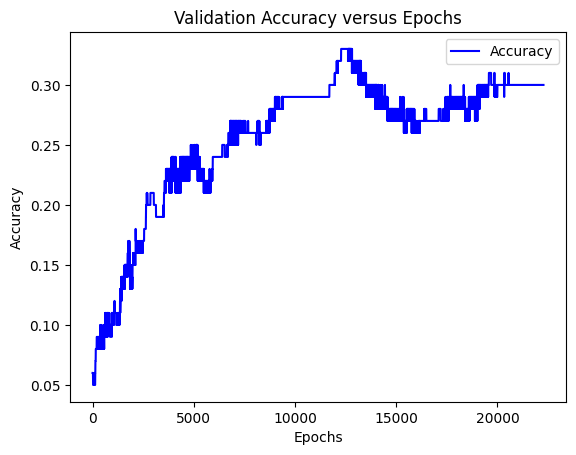

Model Type: full_data_training
Activation: <built-in method atan of type object at 0x00007FF9DFF7BD50>, Number of Layers: 4, Number of Neurons: 64
Time taken to train: 145.74899888038635 seconds
Number of model updates: 24377
Test Accuracy: 0.340000


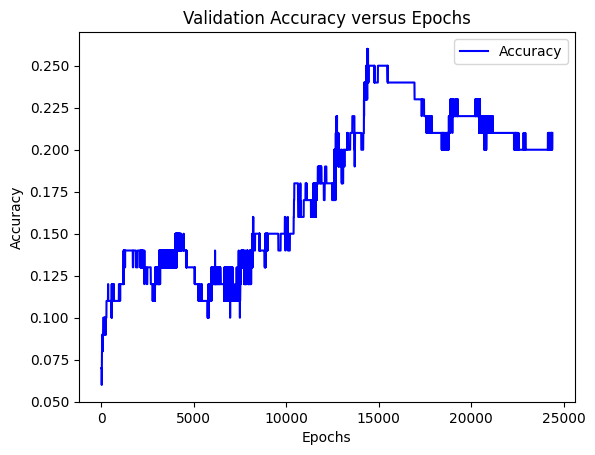

Model Type: mini_batch_training
Activation: <built-in method sigmoid of type object at 0x00007FF9DFF7BD50>, Number of Layers: 2, Number of Neurons: 16
Time taken to train: 106.41803479194641 seconds
Number of model updates: 98664
Test Accuracy: 0.420000


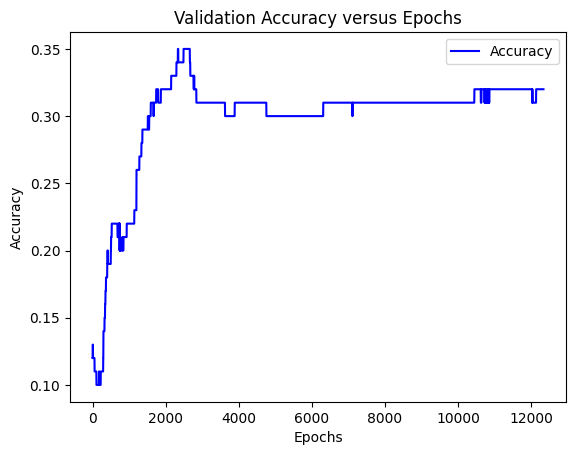

Model Type: mini_batch_training
Activation: <built-in method sigmoid of type object at 0x00007FF9DFF7BD50>, Number of Layers: 2, Number of Neurons: 32
Time taken to train: 208.78996753692627 seconds
Number of model updates: 197672
Test Accuracy: 0.520000


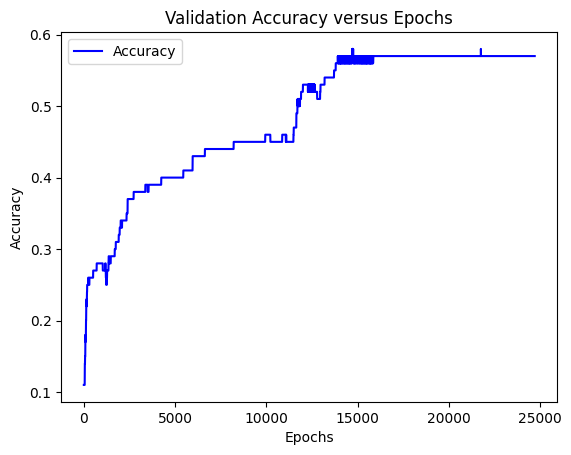

Model Type: mini_batch_training
Activation: <built-in method sigmoid of type object at 0x00007FF9DFF7BD50>, Number of Layers: 2, Number of Neurons: 64
Time taken to train: 202.339608669281 seconds
Number of model updates: 170464
Test Accuracy: 0.600000


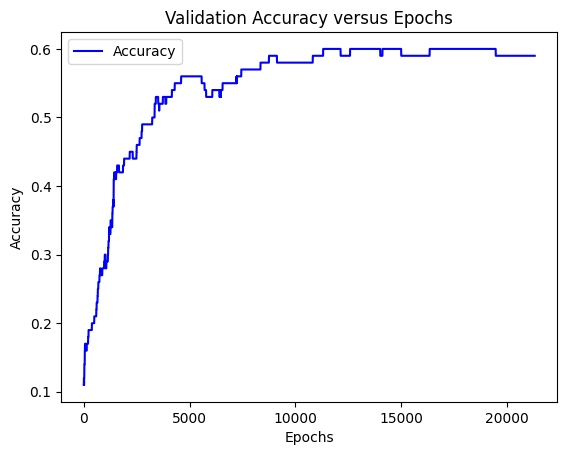

Model Type: mini_batch_training
Activation: <built-in method sigmoid of type object at 0x00007FF9DFF7BD50>, Number of Layers: 3, Number of Neurons: 16
Time taken to train: 170.09832978248596 seconds
Number of model updates: 139608
Test Accuracy: 0.420000


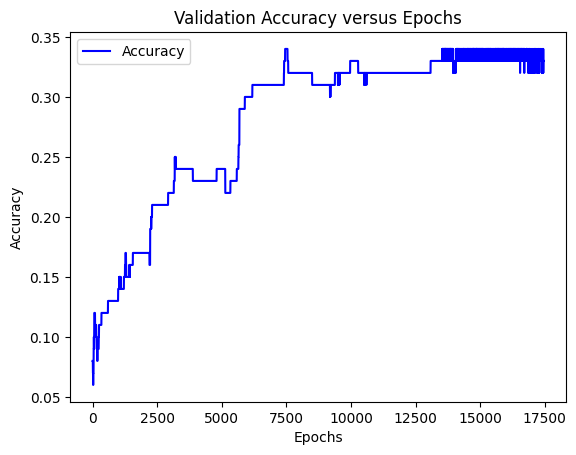

Model Type: mini_batch_training
Activation: <built-in method sigmoid of type object at 0x00007FF9DFF7BD50>, Number of Layers: 3, Number of Neurons: 32
Time taken to train: 356.69396448135376 seconds
Number of model updates: 225928
Test Accuracy: 0.470000


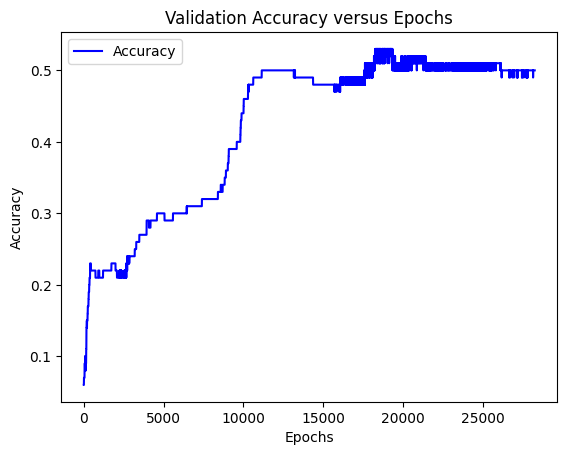

Model Type: mini_batch_training
Activation: <built-in method sigmoid of type object at 0x00007FF9DFF7BD50>, Number of Layers: 3, Number of Neurons: 64
Time taken to train: 372.793172121048 seconds
Number of model updates: 211704
Test Accuracy: 0.650000


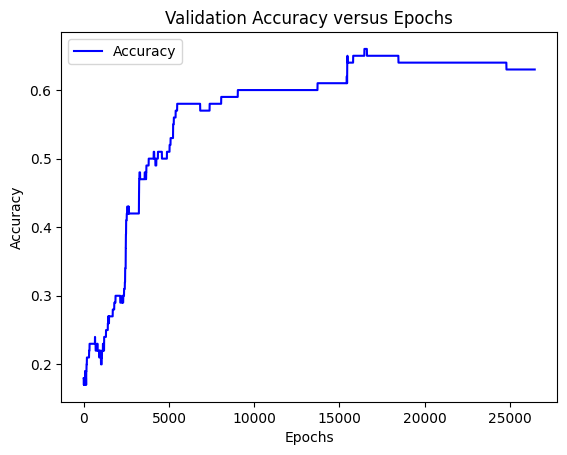

Model Type: mini_batch_training
Activation: <built-in method sigmoid of type object at 0x00007FF9DFF7BD50>, Number of Layers: 4, Number of Neurons: 16
Time taken to train: 476.9677469730377 seconds
Number of model updates: 302960
Test Accuracy: 0.420000


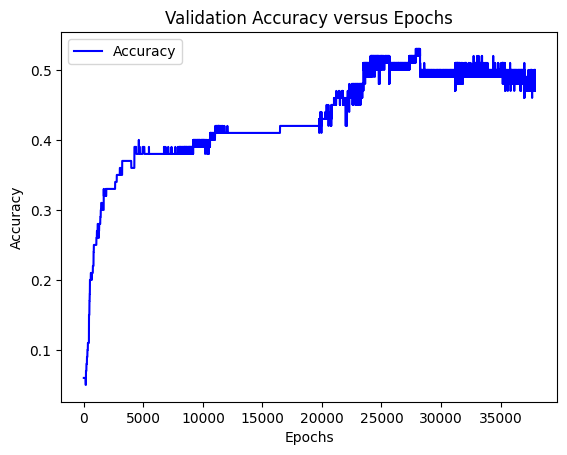

Model Type: mini_batch_training
Activation: <built-in method sigmoid of type object at 0x00007FF9DFF7BD50>, Number of Layers: 4, Number of Neurons: 32
Time taken to train: 241.94103527069092 seconds
Number of model updates: 136576
Test Accuracy: 0.380000


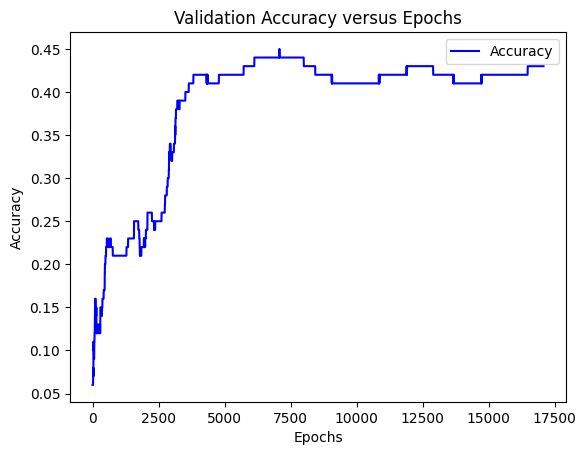

Model Type: mini_batch_training
Activation: <built-in method sigmoid of type object at 0x00007FF9DFF7BD50>, Number of Layers: 4, Number of Neurons: 64
Time taken to train: 222.176029920578 seconds
Number of model updates: 106800
Test Accuracy: 0.650000


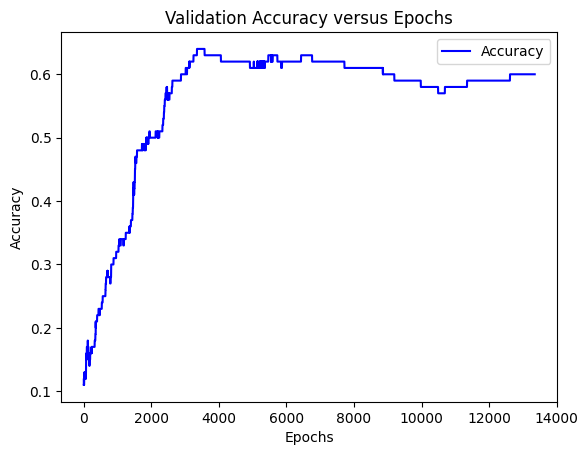

Model Type: mini_batch_training
Activation: <built-in method relu of type object at 0x00007FF9DFF7BD50>, Number of Layers: 2, Number of Neurons: 16
Time taken to train: 104.25500106811523 seconds
Number of model updates: 101192
Test Accuracy: 0.290000


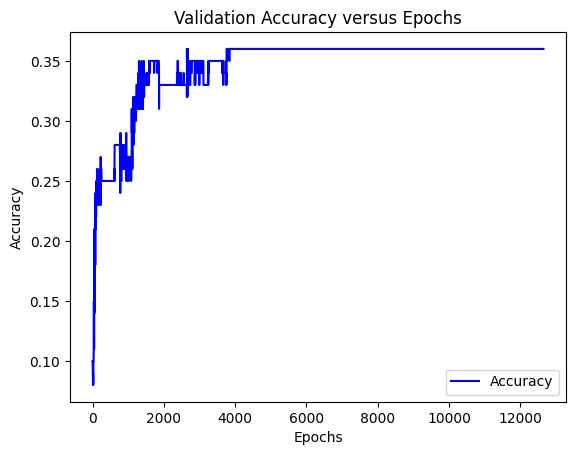

Model Type: mini_batch_training
Activation: <built-in method relu of type object at 0x00007FF9DFF7BD50>, Number of Layers: 2, Number of Neurons: 32
Time taken to train: 85.40600872039795 seconds
Number of model updates: 80168
Test Accuracy: 0.060000


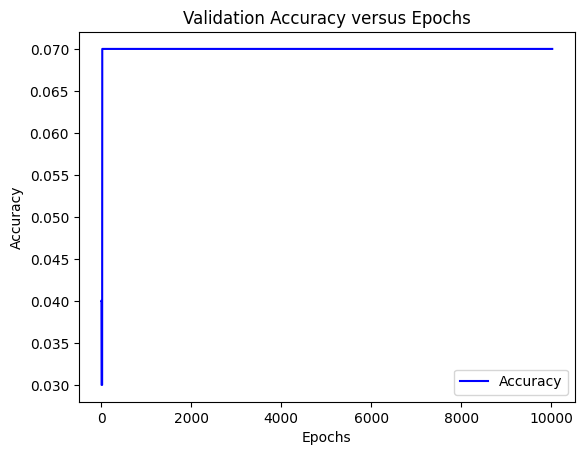

Model Type: mini_batch_training
Activation: <built-in method relu of type object at 0x00007FF9DFF7BD50>, Number of Layers: 2, Number of Neurons: 64
Time taken to train: 93.30700087547302 seconds
Number of model updates: 80016
Test Accuracy: 0.090000


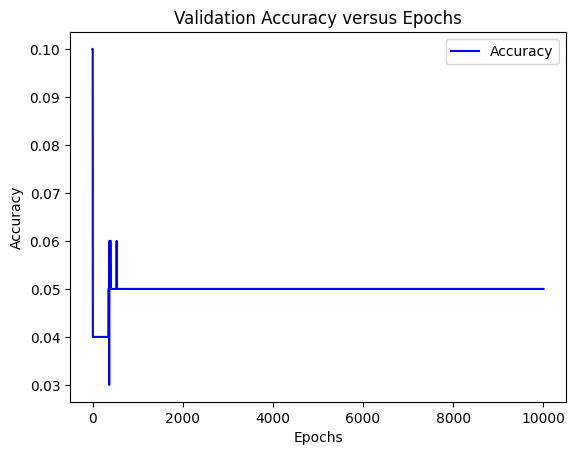

Model Type: mini_batch_training
Activation: <built-in method relu of type object at 0x00007FF9DFF7BD50>, Number of Layers: 3, Number of Neurons: 16
Time taken to train: 117.26801657676697 seconds
Number of model updates: 89120
Test Accuracy: 0.160000


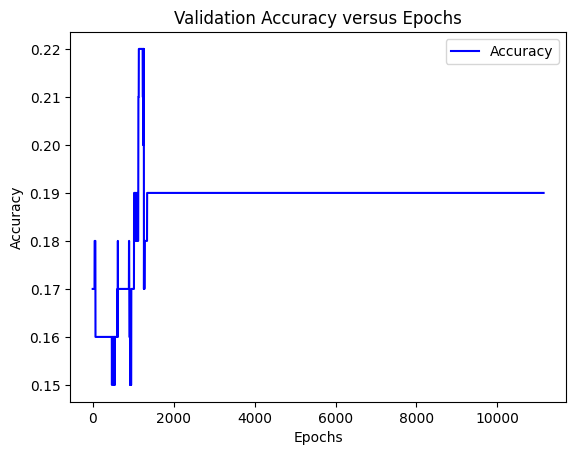

Model Type: mini_batch_training
Activation: <built-in method relu of type object at 0x00007FF9DFF7BD50>, Number of Layers: 3, Number of Neurons: 32
Time taken to train: 112.67799854278564 seconds
Number of model updates: 80024
Test Accuracy: 0.100000


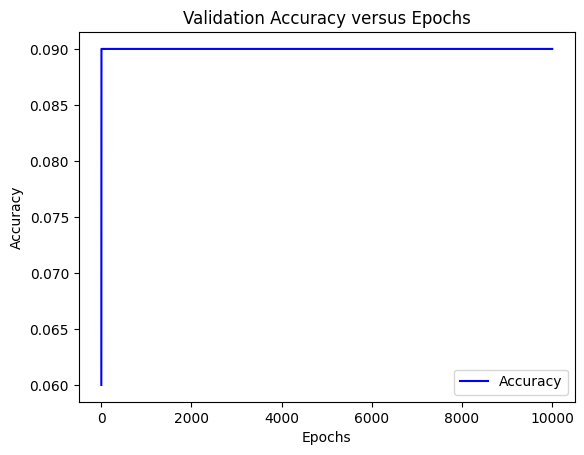

Model Type: mini_batch_training
Activation: <built-in method relu of type object at 0x00007FF9DFF7BD50>, Number of Layers: 3, Number of Neurons: 64
Time taken to train: 123.55751442909241 seconds
Number of model updates: 80016
Test Accuracy: 0.110000


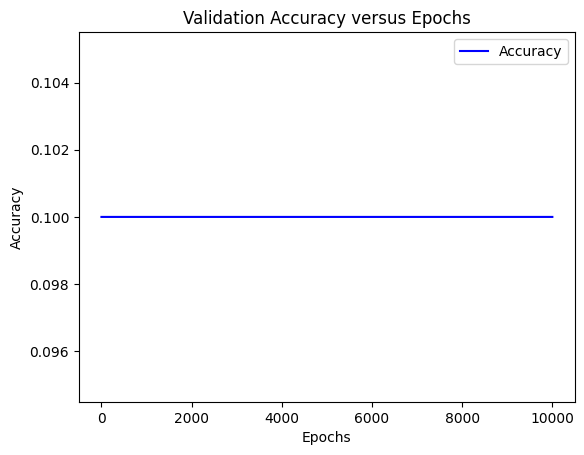

Model Type: mini_batch_training
Activation: <built-in method relu of type object at 0x00007FF9DFF7BD50>, Number of Layers: 4, Number of Neurons: 16
Time taken to train: 125.94299936294556 seconds
Number of model updates: 80344
Test Accuracy: 0.130000


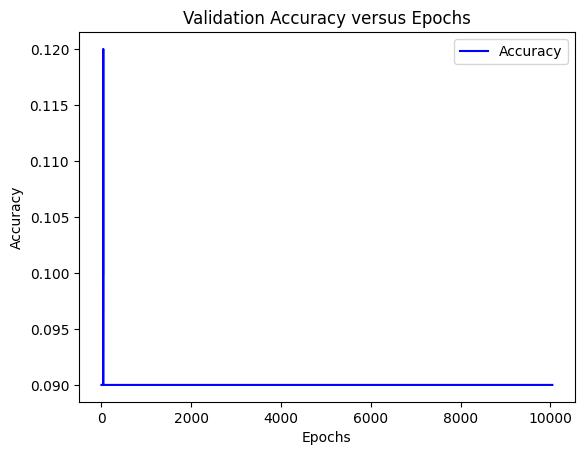

Model Type: mini_batch_training
Activation: <built-in method relu of type object at 0x00007FF9DFF7BD50>, Number of Layers: 4, Number of Neurons: 32
Time taken to train: 136.13837909698486 seconds
Number of model updates: 80016
Test Accuracy: 0.050000


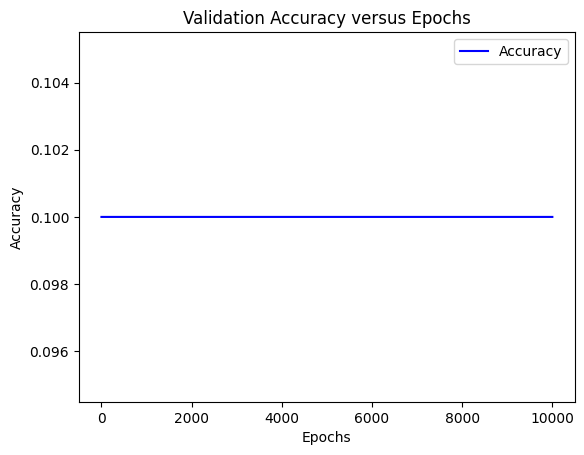

Model Type: mini_batch_training
Activation: <built-in method relu of type object at 0x00007FF9DFF7BD50>, Number of Layers: 4, Number of Neurons: 64
Time taken to train: 149.71836709976196 seconds
Number of model updates: 80016
Test Accuracy: 0.110000


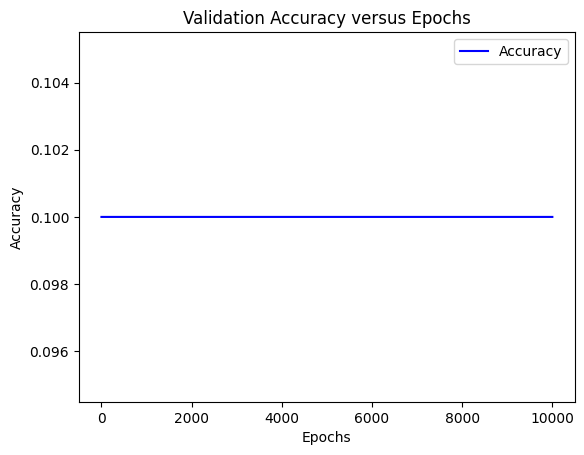

Model Type: mini_batch_training
Activation: <built-in method atan of type object at 0x00007FF9DFF7BD50>, Number of Layers: 2, Number of Neurons: 16
Time taken to train: 189.31099915504456 seconds
Number of model updates: 190712
Test Accuracy: 0.540000


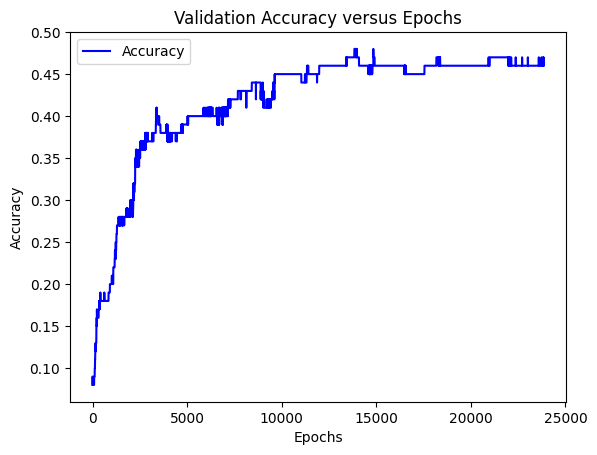

Model Type: mini_batch_training
Activation: <built-in method atan of type object at 0x00007FF9DFF7BD50>, Number of Layers: 2, Number of Neurons: 32
Time taken to train: 156.8950002193451 seconds
Number of model updates: 152200
Test Accuracy: 0.550000


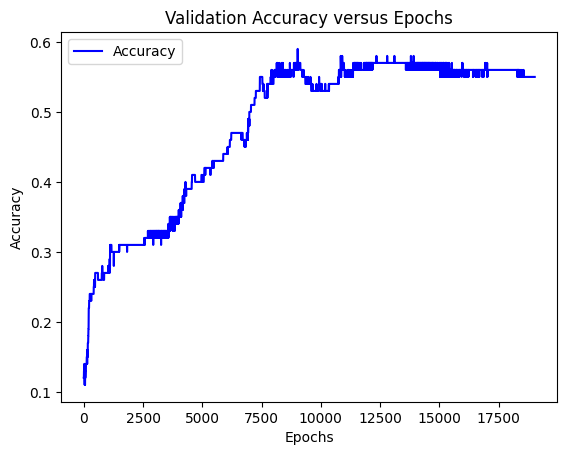

Model Type: mini_batch_training
Activation: <built-in method atan of type object at 0x00007FF9DFF7BD50>, Number of Layers: 2, Number of Neurons: 64
Time taken to train: 165.77299904823303 seconds
Number of model updates: 156536
Test Accuracy: 0.560000


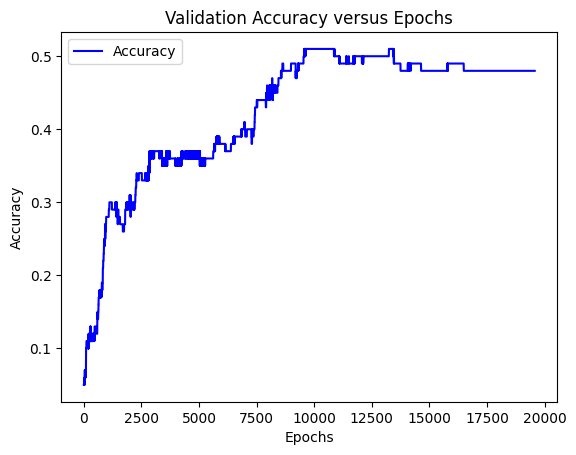

Model Type: mini_batch_training
Activation: <built-in method atan of type object at 0x00007FF9DFF7BD50>, Number of Layers: 3, Number of Neurons: 16
Time taken to train: 203.12903451919556 seconds
Number of model updates: 167120
Test Accuracy: 0.570000


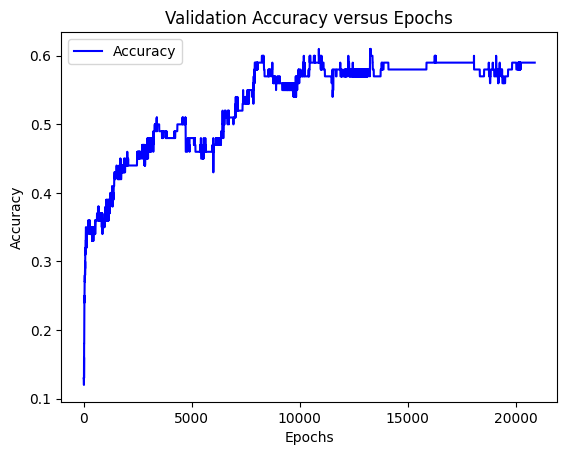

Model Type: mini_batch_training
Activation: <built-in method atan of type object at 0x00007FF9DFF7BD50>, Number of Layers: 3, Number of Neurons: 32
Time taken to train: 182.03299951553345 seconds
Number of model updates: 133392
Test Accuracy: 0.610000


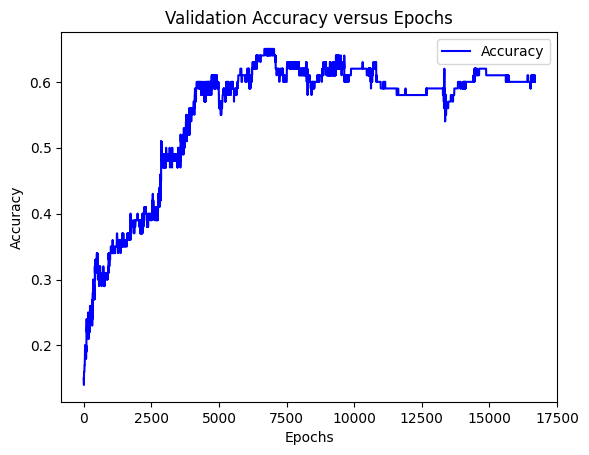

Model Type: mini_batch_training
Activation: <built-in method atan of type object at 0x00007FF9DFF7BD50>, Number of Layers: 3, Number of Neurons: 64
Time taken to train: 492.1434645652771 seconds
Number of model updates: 337800
Test Accuracy: 0.510000


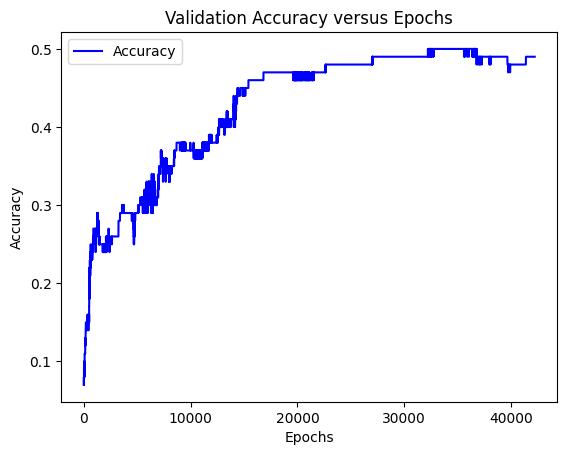

Model Type: mini_batch_training
Activation: <built-in method atan of type object at 0x00007FF9DFF7BD50>, Number of Layers: 4, Number of Neurons: 16
Time taken to train: 196.4380497932434 seconds
Number of model updates: 131128
Test Accuracy: 0.610000


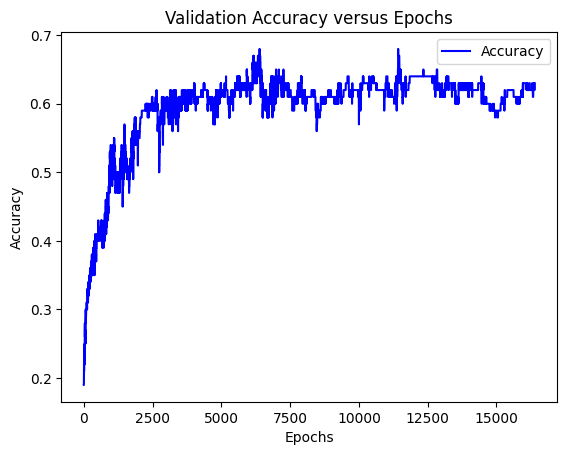

Model Type: mini_batch_training
Activation: <built-in method atan of type object at 0x00007FF9DFF7BD50>, Number of Layers: 4, Number of Neurons: 32
Time taken to train: 208.6200008392334 seconds
Number of model updates: 128344
Test Accuracy: 0.640000


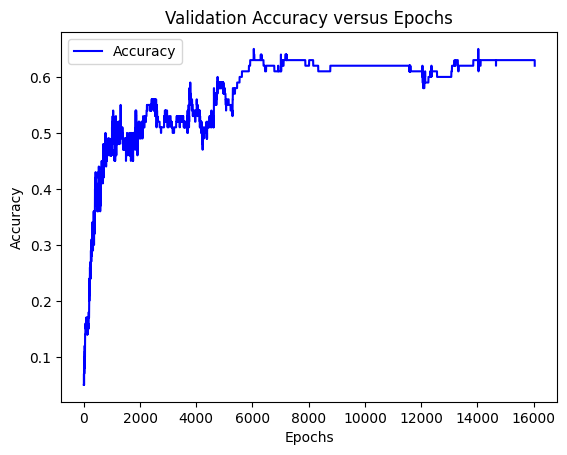

Model Type: mini_batch_training
Activation: <built-in method atan of type object at 0x00007FF9DFF7BD50>, Number of Layers: 4, Number of Neurons: 64
Time taken to train: 656.4901127815247 seconds
Number of model updates: 365952
Test Accuracy: 0.650000


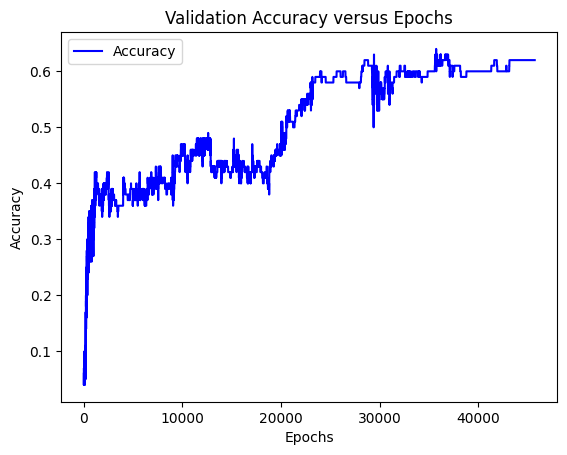

In [ ]:
import matplotlib.pyplot as plt
for model in model_list:
    model_type, model, accuracy_list_over_epochs, time_taken, number_of_model_updates, activation, number_of_layers, number_of_neurons = model
    print(f'Model Type: {model_type}')
    print(f'Activation: {activation}, Number of Layers: {number_of_layers}, Number of Neurons: {number_of_neurons}')
    print(f'Time taken to train: {time_taken} seconds')
    print(f'Number of model updates: {number_of_model_updates}')
    evaluate_test(model, test_images, test_labels, batch_size_test=100)
    epochs = range(1, len(accuracy_list_over_epochs) + 1)
    plt.plot(epochs, accuracy_list_over_epochs, 'b', label='Accuracy')
    plt.title('Validation Accuracy versus Epochs')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.legend()
    plt.show()

| Model Type Trainined          | Activation Function                                  | Number of Layers | Number of Neurons | Training Time (in seconds) | Amount of Model Updates | Test Accuracy |
|---------------------|----------------------------------------------|--------|---------|-------------------------|---------------|---------------|
| full_data_training | sigmoid                                      | 2      | 16      | 209.205                 | 47807         | 0.420         |
| full_data_training | sigmoid                                      | 2      | 32      | 140.183                 | 29461         | 0.430         |
| full_data_training | sigmoid                                      | 2      | 64      | 120.847                 | 24183         | 0.310         |
| full_data_training | sigmoid                                      | 3      | 16      | 224.877                 | 47220         | 0.370         |
| full_data_training | sigmoid                                      | 3      | 32      | 179.922                 | 32166         | 0.470         |
| full_data_training | sigmoid                                      | 3      | 64      | 123.252                 | 19924         | 0.390         |
| full_data_training | sigmoid                                      | 4      | 16      | 284.546                 | 53599         | 0.390         |
| full_data_training | sigmoid                                      | 4      | 32      | 142.070                 | 22007         | 0.500         |
| full_data_training | sigmoid                                      | 4      | 64      | 118.266                 | 16243         | 0.380         |
| full_data_training | relu                                         | 2      | 16      | 57.972                  | 13009         | 0.110         |
| full_data_training | relu                                         | 2      | 32      | 46.776                  | 10002         | 0.060         |
| full_data_training | relu                                         | 2      | 64      | 49.142                  | 10002         | 0.130         |
| full_data_training | relu                                         | 3      | 16      | 49.009                  | 10002         | 0.060         |
| full_data_training | relu                                         | 3      | 32      | 52.329                  | 10002         | 0.130         |
| full_data_training | relu                                         | 3      | 64      | 55.490                  | 10002         | 0.200         |
| full_data_training | relu                                         | 4      | 16      | 52.980                  | 10002         | 0.140         |
| full_data_training | relu                                         | 4      | 32      | 58.201                  | 10002         | 0.110         |
| full_data_training | relu                                         | 4      | 64      | 62.626                  | 10002         | 0.160         |
| full_data_training | atan                                         | 2      | 16      | 75.732                  | 18385         | 0.280         |
| full_data_training | atan                                         | 2      | 32      | 141.310                 | 32946         | 0.580         |
| full_data_training | atan                                         | 2      | 64      | 108.873                 | 24338         | 0.350         |
| full_data_training | atan                                         | 3      | 16      | 61.316                  | 13272         | 0.430         |
| full_data_training | atan                                         | 3      | 32      | 164.921                 | 34105         | 0.460         |
| full_data_training | atan                                         | 3      | 64      | 255.148                 | 48559         | 0.400         |
| full_data_training | atan                                         | 4      | 16      | 155.697                 | 32249         | 0.280         |
| full_data_training | atan                                         | 4      | 32      | 117.388                 | 22277         | 0.390         |
| full_data_training | atan                                         | 4      | 64      | 145.749                 | 24377         | 0.340         |
| mini_batch_training | sigmoid                                      | 2      | 16      | 106.418                 | 98664         | 0.420         |
| mini_batch_training | sigmoid                                      | 2      | 32      | 208.790                 | 197672        | 0.520         |
| mini_batch_training | sigmoid                                      | 2      | 64      | 202.340                 | 170464        | 0.600         |
| mini_batch_training | sigmoid                                      | 3      | 16      | 170.098                 | 139608        | 0.420         |
| mini_batch_training | sigmoid                                      | 3      | 32      | 356.694                 | 225928        | 0.470         |
| mini_batch_training | sigmoid                                      | 3      | 64      | 372.793                 | 211704        | 0.650         |
| mini_batch_training | sigmoid                                      | 4      | 16      | 476.968                 | 302960        | 0.420         |
| mini_batch_training | sigmoid                                      | 4      | 32      | 241.941                 | 136576        | 0.380         |
| mini_batch_training | sigmoid                                      | 4      | 64      | 222.176                 | 106800        | 0.650         |
| mini_batch_training | relu                                         | 2      | 16      | 104.255                 | 101192        | 0.290         |
| mini_batch_training | relu                                         | 2      | 32      | 85.406                  | 80168         | 0.060         |
| mini_batch_training | relu                                         | 2      | 64      | 93.307                  | 80016         | 0.090         |
| mini_batch_training | relu                                         | 3      | 16      | 117.268                 | 89120         | 0.160         |
| mini_batch_training | relu                                         | 3      | 32      | 112.678                 | 80024         | 0.100         |
| mini_batch_training | relu                                         | 3      | 64      | 123.558                 | 80016         | 0.110         |
| mini_batch_training | relu                                         | 4      | 16      | 125.943                 | 80344         | 0.130         |
| mini_batch_training | relu                                         | 4      | 32      | 136.138                 | 80016         | 0.050         |
| mini_batch_training | relu                                         | 4      | 64      | 149.718                 | 80016         | 0.110         |
| mini_batch_training | atan                                         | 2      | 16      | 189.311                 | 190712        | 0.540          |
| mini_batch_training | atan                                         | 2      | 32      | 156.895                 | 152200        | 0.550          |
| mini_batch_training | atan                                         | 2      | 64      | 165.773                 | 156536        | 0.560          |
| mini_batch_training | atan                                         | 3      | 16      | 203.129                 | 167120        | 0.570          |
| mini_batch_training | atan                                         | 3      | 32      | 182.033                 | 133392        | 0.610          |
| mini_batch_training | atan                                         | 3      | 64      | 492.143                 | 337800        | 0.510          |
| mini_batch_training | atan                                         | 4      | 16      | 196.438                 | 131128        | 0.610          |
| mini_batch_training | atan                                         | 4      | 32      | 208.620                 | 128344        | 0.640          |
| mini_batch_training | atan                                         | 4      | 64      | 656.490                 | 365952        | 0.650          |

What is the best architecture? Did mini-batches help with anything? Report any other interesting observations.

The three best architectures were the mini batch trainings using the sigmoid function as the activation, with 3 or 4 layers each with 64 neurons and also the mini-batches using atan with 4 layers and 64 neurons per layer. According to the results it seems that using mini-batches got higher test accuracy on average so it would seem that the mini-batches were effective in this case. Additionally an interesting obeservation was that using relu as an activation function in this case gave very poor results for both the full training and mini-batches.